<a href="https://colab.research.google.com/github/MexBanDoc/MatlabDE/blob/main/Python/Differential_Equesions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Python

In [ ]:
import matplotlib.pyplot as plt
from numba import njit, jit
import numpy as np
from random import random
import datetime

##Numerical

###Common

In [ ]:
delta = np.array([0.0001, 0.0001])

def get_discriminant(b, c, get_tr, get_det):
  return get_tr(b, c) ** 2 - 4 * get_det(b, c)

def sign_f(func):
  return lambda *args: np.sign(func(*args))

num_to_portret = {
    0 : "центр",
    -1 : "устойчивый фокус",
    -2 : "неустойчивый фокус",
    1 : "седло",
    2 : "устойчивый узел",
    3 : "неустойчивый узел",
}

def get_portret_num(discr, trA):
  if discr < 0:
    if abs(trA) < 1e-5:
      return 0
    if trA < 0:
      return -1
    return -2
  
  if abs(trA) < discr ** 0.5:
    return 1
  
  if trA < 0:
    return 2
  return 3

def get_portret(discr, trA):
  num = get_portret_num(discr, trA)
  return num_to_portret[num]

def get_f(a, b, c):
  @njit
  def f(xy: np.array):
    x, y = xy
    x_ = x - c * x * x - a * x * y / (1 + x)
    y_ = -y + b * x * y / (1 + x)
    return np.array([x_, y_])
    
  temp = f(np.array([0, 0]))
  return f

temp_f = get_f(2, 2, 0.1)
temp_f(np.array([1, 1]))

@njit
def circle(xy: np.array) -> np.array:
  x, y = xy
  return np.array([y, -x])

circle(np.array([1, 5]), **{})

@njit
def runge_kutta(s: np.array, f, h=1e-3) -> np.array:
  k_1 = h * f(s)
  k_2 = h * f(s + k_1 / 2)
  k_3 = h * f(s + k_2 / 2)
  k_4 = h * f(s + k_3)
  s_ = s + (k_1 + 2*k_2 + 2*k_3 + k_4) / 6
  return s_

runge_kutta(np.array([1, 1]), circle)

@njit
def euler(x: np.array, f, h=0.001) -> np.array:
  dx = f(x)
  x_ = x + h * dx
  return x_

euler(np.array([1, 1]), circle)

@njit
def get_trace(x0: np.array, f, n=100, h=1e-3):
  points = np.zeros((n, 2))
  points[0] = x0

  for i in range(1, n):
    x = points[i-1]

    # points[i] = euler(x, f)
    points[i] = runge_kutta(x, f, h)

  return points

get_trace(np.array([1, 1]), circle, 2)

@njit
def get_circular_points(n: int = 10, r: float = 1, rads=2*np.pi):
  circular_points = np.zeros((n, 2))
  for i, rad in enumerate(np.linspace(0, rads, n)):
    circular_points[i] = np.array([np.cos(rad), np.sin(rad)])
  return circular_points * r

get_circular_points(3)

def logProgress(curr):
  if curr == 0:
    print('[', end='')
  if curr % 10 == 0:
    print(f']{curr // 10}[', end='')

@njit
def rand_dxdy():
  a, b = random(), random()
  e = (-2 * np.log(a)) ** 0.5 * np.cos(2 * np.pi * b)
  q = (-2 * np.log(a)) ** 0.5 * np.sin(2 * np.pi * b)
  return np.array([e, q])

# def get_stachastic_f(a, b, c):
#   pass

@njit
def stochastic_runge_kutta(s: np.array, f, h=0.01, eps=0.001) -> np.array:
  return runge_kutta(s, f, h) + eps * (h ** 0.5) * rand_dxdy()

@njit
def get_stochastic_trace(x0: np.array, f, h=0.01, eps=0.01, n=100):
  points = np.zeros((n, 2))
  points[0] = x0

  for i in range(1, n):
    x = points[i-1]

    points[i] = stochastic_runge_kutta(x, f, h, eps)

  return points

print(f"DONE {datetime.datetime.now()}")

DONE 2021-12-23 07:31:35.644917


###$M_1$

In [ ]:
def get_m1(a, b, c):
  return np.array([1/c, 0])

def get_m1_tr(b, c):
  return (b - 2 * c - 2) / (c + 1)

def get_m1_det(b, c):
  return (c + 1 - b) / (c + 1)

get_m1_discriminant = lambda b, c: get_discriminant(b, c, get_m1_tr, get_m1_det)

###$M_2$

In [ ]:
def get_m2(a, b, c):
  return np.array([1/(b - 1), (b-c-1) * b / (a * (b - 1) ** 2)])

def get_m2_tr(b, c):
  return (c + 1) / b - 2 * c / (b - 1)

def get_m2_det(b, c):
  return (b-c-1) / b

get_m2_discriminant = lambda b, c: get_discriminant(b, c, get_m2_tr, get_m2_det)

def get_m2_portret_num(b, c):
  d = get_m2_discriminant(b, c)
  trA = get_m2_tr(b, c)
  return get_portret_num(d, trA)

def get_m2_portret(b, c):
  discr = get_m2_discriminant(b, c)
  trA = get_m2_tr(b, c)
  return get_portret(discr, trA)

@njit
def cycle_point_conditon(m2, point1, point2):
  x_, y_ = m2
  x1, y1 = point1
  x2, y2 = point2
  return x1 > x_ and x2 > x_ and (y_ - y1) * (y_ - y2) < 0

@njit
def get_x_p(m2, point1, point2):
  v = point2 - point1
  dy = m2[1] - point1[1]
  x_p = point1 + v * (dy / v[1])
  return x_p

@njit
def go_one_round(m2, f_abc, point):
  prev_point = point
  # i = 0
  while True:
    # i += 1
    curr_point = runge_kutta(prev_point, f_abc, 0.001)
    if cycle_point_conditon(m2, curr_point, prev_point):
      x_p = get_x_p(m2, prev_point, curr_point)
      return x_p
    prev_point = curr_point

@njit
def find_m2_cycle_point(m2, f_abc, epsilon=1e-3, max_iter=10000):
  x_p = go_one_round(m2, f_abc, m2 + np.array([0.02, 0]))
  for i in range(max_iter):
    x_p_1 = go_one_round(m2, f_abc, x_p)
    # plt.plot(*x_p_1, 'o')
    # print(x_p_1)
    if abs(x_p[0] - x_p_1[0]) < epsilon:
      return x_p_1
    x_p = x_p_1
  return x_p_1

def get_m2_cycle(a, b, c, epsilon=1e-3, h=0.001):
  m2 = get_m2(a, b, c)
  f_abc = get_f(a, b, c)
  point = find_m2_cycle_point(m2, f_abc)
  points = [point]
  prev_point = point
  while True:
    curr_point = runge_kutta(prev_point, f_abc, h)
    points.append(curr_point)
    if cycle_point_conditon(m2, curr_point, prev_point):
      return np.array(points)
    prev_point = curr_point

get_m2_cycle(2, 12/9, 0.1)

def intersect_d_trA(b, c):
  trA = np.sign(get_m2_tr(b, c))
  d = np.sign(get_m2_discriminant(b, c))
  return trA * 3 + d

def intersect_d_trA_detA(b, c):
  inter = intersect_d_trA(b, c)
  detA = np.sign(get_m2_det(b, c))
  return inter + detA * 3


print(f'Complete {datetime.datetime.now()}')

Complete 2021-12-23 07:31:38.465992


In [ ]:
def get_m2_track_sups(m_2, f_abc, steps):
  track = get_trace(m_2 + 0.01, f_abc, steps)[steps//2:]
  xs = track[:,0]
  ys = track[:,1]
  return xs.min(), ys.min(), xs.max(), ys.max()

get_m2_track_sups(np.array([15, 15]), get_f(2, 2, 0.1), 500)

def get_sups(a, bs, c, steps=500):
  mins, ms, maxs = [], [], []
  # 40, 50000 - 1min
  # 40, 500000 - 2min

  for i, b in enumerate(bs):
    # logProgress(i)
    m_2 = np.array([1/(b - 1), (b-c-1) * b / (a * (b - 1) ** 2)])
    f_abc = get_f(a, b, c)
    x_min, y_min, x_max, y_max = get_m2_track_sups(m_2, f_abc, steps)
    
    mins.append((x_min, y_min))
    ms.append(m_2)
    maxs.append((x_max, y_max))

  return np.array(mins), np.array(ms), np.array(maxs)
  
get_sups(2, np.linspace(2, 3, 5), 0.1)

(array([[1.00591013, 0.91103239],
        [0.80633342, 0.83933588],
        [0.67330895, 0.78941924],
        [0.57830667, 0.75276489],
        [0.50706415, 0.72475681]]), array([[1.        , 0.9       ],
        [0.8       , 0.828     ],
        [0.66666667, 0.77777778],
        [0.57142857, 0.74081633],
        [0.5       , 0.7125    ]]), array([[1.00815462, 0.91183125],
        [0.80837208, 0.84040416],
        [0.67519856, 0.7907625 ],
        [0.58008351, 0.75438703],
        [0.50875286, 0.72666074]]))

##Plots

In [ ]:
plt.rcParams['figure.figsize'] = [7, 7]

def plot_zones(b, c, f, fig_name=None):
  z = f(b, c)

  fig, ax = plt.subplots()

  im = ax.pcolormesh(b, c, z)
  ax.set_xlabel("b")
  ax.set_ylabel("c", rotation=0)
  fig.colorbar(im, ax=ax)
  fig.set_size_inches(15, 10)
  if fig_name:
    fig.savefig(fig_name)
  plt.show(fig)

def plot_tracks(start_points: np.array, f, steps: int=10000, fig=plt):
  for start_point in start_points:
    track = get_trace(start_point, f, steps)
    fig.plot(*track[0], marker='o', markersize=5)
    fig.plot(track[:,0], track[:,1])

  if fig == plt:
    fig.xlabel('x', size='xx-large')
    fig.ylabel('y', size='xx-large')
  else:
    fig.set_xlabel('x')
    fig.set_ylabel('y')
  
  # fig.savefig('big_biba.png')
  # fig.close()

def plot_m1_tracks(a, b, c, steps=500, fig=plt):
  m1 = get_m1(a, b, c)
  starting_points = m1 + get_circular_points(15, 0.001, np.pi)
  f_abc = get_f(a, b, c)

  fig.annotate("$M_1$", m1)
  plot_tracks(starting_points, f_abc, steps, fig)

def plot_m2_tracks(a, b, c, steps=500, fig=plt, start_points=10):
  m_2 = get_m2(a, b, c)
  starting_points = m_2 + get_circular_points(start_points, 0.001)[1:]
  f_abc = get_f(a, b, c)

  title = f'{get_m2_portret(b, c)}\na={a};b={b:.3f};c={c}'

  if fig == plt:
    fig.title(title)
  else:
    fig.set_title(title)
  
  fig.annotate("$M_2$", m_2)
  fig.plot(*m_2, marker='o', markersize=5)
  fig.grid(linewidth=0.1)
  plot_tracks(starting_points, f_abc, steps, fig)

def plot_m2_cycle(a, b, c, fig=plt):
  # print(cycle_point)
  m2 = get_m2(a, b, c)
  cycle = get_m2_cycle(a, b, c)

  fig.plot(*m2, marker='o')
  fig.plot(*cycle[0], marker='o')
  fig.plot(cycle[:,0], cycle[:,1])

def plot_phase_portret(a, b, c):
  m0 = np.array([0, 0])
  plt.annotate('$M_0$', m0)
  m1 = get_m1(a, b, c)
  m2 = get_m2(a, b, c)
  
  start_points = m0 + get_circular_points(4, 0.01, np.pi / 2)
  start_points = np.concatenate(start_points, m1 + 0)

def get_common_start_points():
  start_points = [(k, k) for k in [3, 4, 5]]
  start_points += [(k, 2) for k in [3, 5 ,8]]
  start_points += [(k, 1) for k in [8, 9]]
  start_points += [(2, 0.5), (11, 1), (11, 0), (8, 4)]
  return np.array(start_points)

def plot_point(point, name, fig):
  fig.plot(*point, 'o')
  fig.annotate(name, point)

def plot_m_points(fig):
  m0 = np.array([0, 0])
  fig.plot(*m0, 'o')
  fig.annotate('$M_0$', m0 - 0.2)
  plot_point(get_m1(a, b, c), '$M_1$', fig)
  plot_point(get_m2(a, b, c), '$M_2$', fig)

def make_legend(a, b, c, fig=plt):
  fig.title(f'a={a}, b={b}, c={c}')

def plot_cycle_period(a, c, b_min, b_max, steps):
  bs = np.linspace(b_min, b_max, steps)
  ts = []
  h = 0.001
  for b in bs:
    cycle = get_m2_cycle(a, b, c, h=h)
    ts.append(len(cycle) * h)
  
  plt.plot(bs, ts)
  plt.xlabel('b', size='xx-large')
  plt.ylabel('T', size='xx-large')

def plot_stochastic_traces(start, f_abc, h=1e-3, eps=1e-4, steps=100):
  trace = get_stochastic_trace(start, f_abc, h, eps, steps)
  xs, ys = trace[:,0], trace[:,1]

  plt.plot(xs, ys, lw=1/5)
  plt.plot(*start, 'o', ms=5)
  
  plt.title(f"Траектории стахостической системы с шумом {eps}")
  plt.xlabel("x", size='x-large')
  plt.ylabel('y', size='x-large')
  plt.savefig("stoch_traj.png")
  plt.show()
  
  t = np.linspace(0, steps * h, steps)
  fig, axs = plt.subplots(2)
  for i, ss in enumerate([xs, ys]):
    axs[i].plot(t, ss)
    axs[i].plot([t[0], t[-1]], [ss[0], ss[0]], lw=0.5)

    axs[i].set_title("Временной ряд " + 'xy'[i])
    axs[i].set_xlabel("T", size='x-large')
    axs[i].set_ylabel('xy'[i], size='x-large')
  
  del trace, xs, ys
    
  fig.set_size_inches(20, 12)
  fig.savefig("stochastic_coords.png")
  
  plt.show()

def plot_stochastic_m2(a, b, c, h=1e-3, eps=0.001, steps=1000):
  f_abc = get_f(a, b, c)
  m2 = get_m2(a, b, c)
  
  plot_stochastic_traces(m2 + 0.001, f_abc, h, eps, steps)

#Популяцонная модель Базыкина

$\begin{cases}
  ẋ = x-cx^2-a\dfrac{xy}{1+x}\\
  ẏ = -y + b\dfrac{xy}{1+x}
\end{cases}$

x - Численность жертв

y - Численность хищников

a, b, c > 0

a=2, c=0.1, b > 1

#Ананилиз системы

$\begin{cases}
  0 = x-cx^2-a\dfrac{xy}{1+x}\\
  0 = -y + b\dfrac{xy}{1+x}
\end{cases}$

$\begin{cases}
  0 = x(1-cx-a\dfrac{y}{1+x})\\
  0 = y(b\dfrac{x}{1+x} - 1)
\end{cases}$

$y(1 - b\dfrac{x}{1+x}) = 0 \Rightarrow \left[ \begin{gathered} 
  y = 0 \\
  1-b\dfrac{x}{1+x} = 0
\end{gathered} 
\right.$

$\textbf{Случай [y=0]:}$

$\begin{cases}
  0 = x-cx^2-a\dfrac{xy}{1+x}\\
  y = 0
\end{cases}
 \Rightarrow x - cx^2 = 0$

$x(1-cx)=0 \Rightarrow
\left[ 
\begin{gathered} 
  x = 0 \\
  1 - cx = 0
\end{gathered} 
\right.
\Leftrightarrow
\left[ 
\begin{gathered} 
  x = 0 \\
  x = \frac{1}{c}
\end{gathered} 
\right.$ 

$\textbf{Случай}$ $[1-b\dfrac{x}{1+x} = 0]$:

$1+x-bx = 0$

$(1-b)x = -1$

$x = \dfrac{1}{b-1}$

$0=x-cx^2-a\dfrac{xy}{1+x}$
$\Leftrightarrow_{[x \ne 0]}$
$0 = 1 - cx - a \dfrac{y}{1 + x}$

$\dfrac{ay}{1+x}=1-cx$

$[1+x=1+\dfrac{1}{b-1}=\dfrac{b-1+1}{b-1}=\dfrac{b}{b-1}]$

$\dfrac{ay(b-1)}{b}=1-\dfrac{c}{b-1}=\dfrac{b-c-1}{b-1}$

$y=\dfrac{(b-c-1)b}{a(b-1)^2}$

##Матрица Якоби

$\left(
\begin{matrix}
-2cx+1-\dfrac{ay}{(x+1)^2} & -\dfrac{ax}{x+1}\\
\dfrac{by}{(x+1)^2} & -1 + \dfrac{bx}{x+1}
\end{matrix}
\right)$

##Характеристический

$\left|
\begin{matrix}
(-2cx+1-\dfrac{ay}{(x+1)^2}) - λ & -\dfrac{ax}{x+1}\\
\dfrac{by}{(x+1)^2} & (-1 + \dfrac{bx}{x+1})-λ
\end{matrix}
\right|=$

$
[(-2cx+1-\frac{ay}{(x+1)^2}) - λ] * [(-1 + \frac{bx}{x+1})-λ] + [\frac{ax}{x+1}] * [\frac{by}{(x+1)^2}] = 
$

$
=
λ^2 - (-2cx+1-\frac{ay}{(x+1)^2}-1 + \frac{bx}{x+1})λ + (-2cx+1-\frac{ay}{(x+1)^2})*(-1 + \frac{bx}{x+1}) + (\frac{axby}{(x+1)^3})=
$

$
=
λ^2 + (2cx+\frac{ay-bx(x+1)}{(x+1)^2})λ + (2cx-1+\frac{ay}{(x+1)^2}- 2cx\frac{bx}{x+1} + \frac{bx}{x+1} - \frac{aybx}{(x+1)^3}) + (\frac{axby}{(x+1)^3})=
$

$
=
λ^2 + (2cx+\frac{ay-bx(x+1)}{(x+1)^2})λ + (2cx+\frac{ay+bx(x+1)}{(x+1)^2}) - (2cx\frac{bx}{x+1} + 1)
$

##Точки покоя

###1) $M_0(0,0)$

$λ^2 - 1 = 0 \Rightarrow λ_{1,2}=\pm1 \Rightarrow Saddle$

###2) $M_1(\frac{1}{c}, 0)$

$
λ^2 + (2-\frac{bx}{x+1})λ + (2+\frac{bx}{x+1}) - (2\frac{bx}{x+1} + 1)
=[\frac{x}{x+1}=\frac{1}{c}\frac{c}{1+c}=\frac{1}{1+c}]=
$

$
=λ^2 + (2-\frac{b}{c+1})λ + (1-\frac{b}{c+1})=
$

$
=
λ^2 + (\frac{2c + 2 - b}{c+1})λ + \frac{c+1-b}{c+1} = 0
$

$trA=-\dfrac{2c + 2 - b}{c+1}=\dfrac{b - 2c - 2}{c+1}$

$detA=\dfrac{c+1-b}{c+1}$

$D=(trA)^2-4detA=\dfrac{(b - 2c - 2)^2-4(c+1-b)(c+1)}{(c+1)^2}$

$D \lor 0$

$(b - 2c - 2)^2-4(c+1-b)(c+1) \lor 0$

$(b - 2(c + 1))^2-4(c+1-b)(c+1) \lor 0$

$[c+1=g]$

$(b-2g)^2-4g(g-b) \lor 0$

$b^2-4bg+4g^2-4g^2+4bg \lor 0$

$b^2 > 0 \Rightarrow D > 0 \Rightarrow вещественные\ корни$

$\sqrt{D}=\dfrac{b}{c+1}$

$λ_{1,2}=\dfrac{1}{2}(\dfrac{b - 2c - 2}{c+1} \pm \dfrac{b}{c+1})$

$λ_1=-1$

$λ_2=\dfrac{b-c-1}{c+1}$

$\left[ 
\begin{array}{l}
  b > c + 1 \Rightarrow Saddle \\
  b \le c + 1 \Rightarrow Stable\ Node
\end{array}
\right.$

$b < c + 1$

$trA=\dfrac{b - 2c - 2}{c+1}<\dfrac{c + 1 - 2c - 2}{c+1}=-1$

$trA<-1$

In [ ]:
t = np.linspace(0.001, 3, 200)
b, c = np.meshgrid(t + 1, t)
plot_zones(b, c, sign_f(get_m1_tr))
plot_zones(b, c, sign_f(get_m1_det))

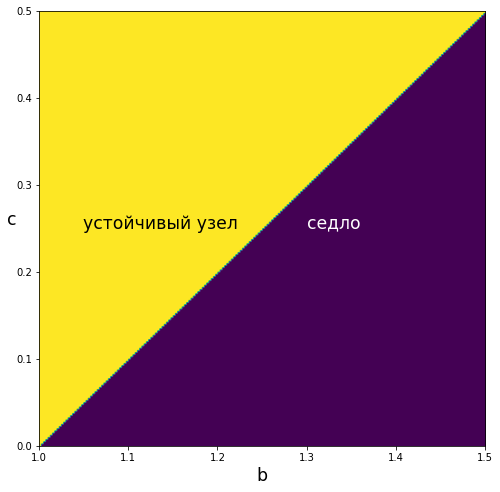

In [ ]:
side = 0.5

bs = np.linspace(1.001, 1 + side, 200)
cs = np.linspace(0.001, side, 200)

karta = np.zeros((len(cs), len(bs)))

for i, b in enumerate(bs):
  for j, c in enumerate(cs):
    discr = get_m1_discriminant(b, c)
    trA = get_m1_tr(b, c)
    karta[-j-1, i] = get_portret_num(discr, trA)

fig, ax = plt.subplots(figsize=(8,8))

im = ax.imshow(karta, extent=[1,1+side,0,side], aspect='auto')
# fig.colorbar(im, ax=ax)
ax.set_xlabel('b', size='xx-large')
ax.set_ylabel('c', rotation=0, size='xx-large')
for b, c, color in [(1.3, 0.25, '#fff'), (1.05, 0.25, '#000')]:
  discr = get_m1_discriminant(b, c)
  trA = get_m1_tr(b, c)
  ax.annotate(get_portret(discr, trA), (b, c), color=color, size='xx-large')
# ax.set_title("Типы фазовых потртетов $M_1$")
fig.savefig("m1_portret_types.png")
fig.show()

###3) $M_2(x = \frac{1}{b-1}, y=\frac{(b-c-1)b}{a(b-1)^2})$


$
λ^2 + (2cx+\frac{ay-bx(x+1)}{(x+1)^2})λ + (2cx+\frac{ay+bx(x+1)}{(x+1)^2}) - (2cx\frac{bx}{x+1} + 1)=
$

$=[\dfrac{bx}{x+1}=\dfrac{b}{b-1}\dfrac{b-1}{b}=1]=$

$=λ^2 + (2cx+\frac{ay}{(x+1)^2}-1)λ + (2cx+\frac{ay}{(x+1)^2}+1) - (2cx + 1)=$

$=[\dfrac{ay}{(x+1)^2}=\dfrac{a(b-c-1)b}{a(b-1)^2}\dfrac{(b-1)^2}{b^2}=\dfrac{b-c-1}{b}]=$

$=λ^2 + (2cx+\frac{b-c-1}{b}-1)λ + (2cx+\frac{b-c-1}{b}) - 2cx=$

$=λ^2 + (\frac{2c}{b-1}-\frac{c+1}{b})λ + \frac{b-c-1}{b}=$

$=λ^2 + (\frac{2bc-(c+1)(b-1)}{b(b-1)})λ + \frac{b-c-1}{b}=$

$=λ^2 + (\frac{bc-b+c+1}{b(b-1)})λ + \frac{b-c-1}{b}$

$trA=\dfrac{c+1}{b}-\dfrac{2c}{b-1}=-\dfrac{bc-b+c+1}{b(b-1)}$

$detA=\dfrac{b-c-1}{b}$

<!-- Ошибок нет -->

$D=(trA)^2-4detA=\dfrac{(bc-b+c+1)^2}{b^2(b-1)^2}-4\dfrac{b-c-1}{b}=$

$=\dfrac{(bc-b+c+1)^2-4(b-c-1)b(b-1)^2}{b^2(b-1)^2}$

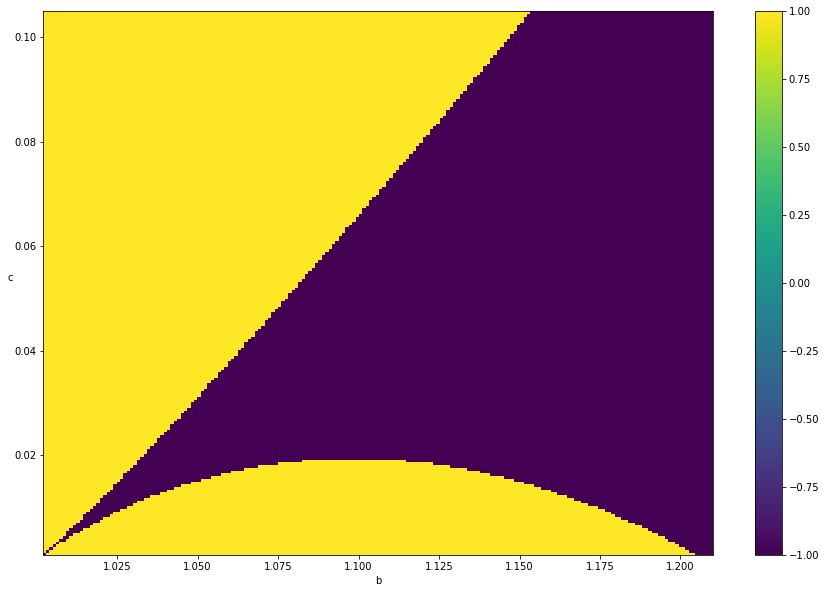

In [ ]:
t = np.linspace(0.001, 0.105, 200)
b, c = np.meshgrid(2 * t + 1, t)
plot_zones(b, c, sign_f(get_m2_discriminant))

Оценим $[0 < с \ll b]$ чтобы посмотреть где заканчивается нижная дуга

$D=\dfrac{(bc-b+c+1)^2-4(b-c-1)b(b-1)^2}{b^2(b-1)^2} \rightarrow$
$\dfrac{(-b+1)^2-4(b-1)b(b-1)^2}{b^2(b-1)^2}$

$\dfrac{(-b+1)^2-4(b-1)b(b-1)^2}{b^2(b-1)^2}=\dfrac{1-4(b-1)b}{b^2}$

$1-4(b-1)b=0$

$b_{1,2}=\dfrac12\pm\dfrac{1}{\sqrt2}\Rightarrow b=\dfrac12+\dfrac{1}{\sqrt2}$

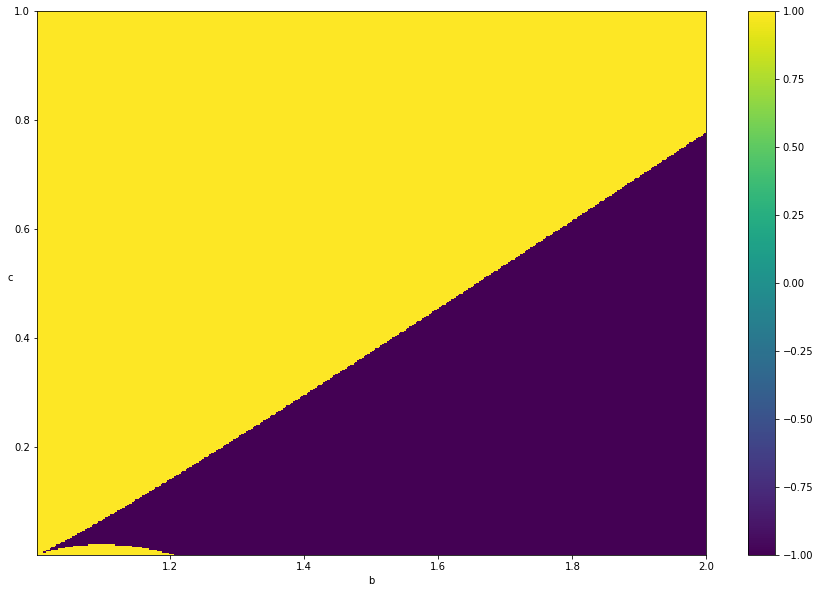

In [ ]:
t = np.linspace(0.001, 1, 400)
b, c = np.meshgrid(t+1, t)
plot_zones(b, c, sign_f(get_m2_discriminant))

Найдем асимптоту $c \approx k(b-1)$

$k>0$

$$\lim_{b\to\infty}\dfrac{(bc-b+c+1)^2-4(b-c-1)b(b-1)^2}{b^2(b-1)^2} = 0$$

$$\lim_{b\to\infty}\dfrac{(c(b+1)-(b-1))^2-4((b-1)-c)b(b-1)^2}{b^2(b-1)^2} = 0$$

$$\lim_{b\to\infty}\dfrac{(k(b-1)(b+1)-(b-1))^2-4((b-1)-k(b-1))b(b-1)^2}{b^2(b-1)^2} = 0$$

$$\lim_{b\to\infty}\dfrac{(b-1)^2(k(b+1)-1)^2-4(b-1)(1-k)b(b-1)^2}{b^2(b-1)^2} = 0$$

$$\lim_{b\to\infty}\dfrac{(k(b+1)-1)^2-4(b-1)(1-k)b}{b^2} = 0$$

$k^2-4(1-k)=0 \Rightarrow k = 2(\sqrt2-1)$

$D=(trA)^2-4detA=\dfrac{(bc-b+c+1)^2}{b^2(b-1)^2}-4\dfrac{b-c-1}{b}=$

$=\dfrac{(bc-b+c+1)^2-4(b-c-1)b(b-1)^2}{b^2(b-1)^2}$

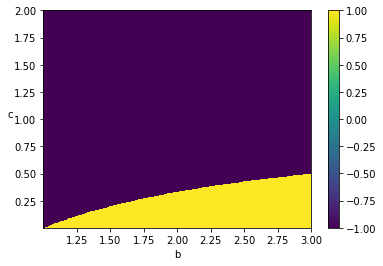

In [ ]:
t = np.linspace(0.001, 2, 400)
b, c = np.meshgrid(t+1, t)
plot_zones(b, c, sign_f(get_m2_tr))

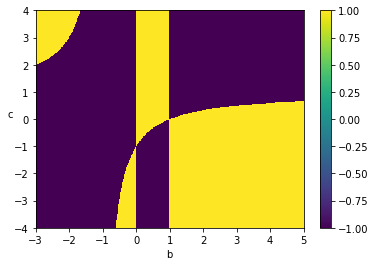

In [ ]:
t = np.linspace(-4, 4, 400)
b, c = np.meshgrid(t+1, t)
plot_zones(b, c, sign_f(get_m2_tr))

$trA=\dfrac{c+1}{b}-\dfrac{2c}{b-1}=0$

$\dfrac{c+1}{b}=\dfrac{2c}{b-1}$

$\dfrac{c+1}{2c}=\dfrac{b}{b-1}$

$\dfrac12+\dfrac{1}{2c}=1+\dfrac{1}{b-1}$

$\dfrac{1}{2c}=\dfrac12+\dfrac{1}{b-1}$

$\dfrac{1}{c}=\dfrac{b+1}{b-1}$

$c=\dfrac{b-1}{b+1}=1-\dfrac{2}{b+1}$

In [ ]:
t = np.linspace(0.01, 2, 400)
b, c = np.meshgrid(t+1, t)
plot_zones(b, c, intersect_d_trA)

$c \approx 2(\sqrt2-1)(b-1)$

$D \approx 0 \Rightarrow λ_1 \approx λ_2 \approx trA$

$trA = \dfrac{c+1}{b}-\dfrac{2c}{b-1} \approx \dfrac{2(\sqrt2-1)(b-1)+1}{b}-\dfrac{4(\sqrt2-1)(b-1)}{b-1}$

In [ ]:
t = np.linspace(0, 3, 100)
b, c = np.meshgrid(t+1, t)
plot_zones(b, c, sign_f(get_m2_det))

In [ ]:
side = 0.4
n = 1000
bs = np.linspace(1.001, 1 + side, n)
cs = np.linspace(0.001, side, n)

In [ ]:
b, c = np.meshgrid(bs, cs)
plot_zones(b, c, intersect_d_trA_detA, "m2_zones.png")

In [ ]:
karta = np.zeros((len(cs), len(bs)))

for i, b in enumerate(bs):
  for j, c in enumerate(cs):
    karta[-j-1, i] = get_m2_portret_num(b, c)

{0: 'центр', -1: 'устойчивый фокус', -2: 'неустойчивый фокус', 1: 'седло', 2: 'устойчивый узел', 3: 'неустойчивый узел'}
['седло', 'устойчивый узел', 'устойчивый фокус', 'неустойчивый фокус']


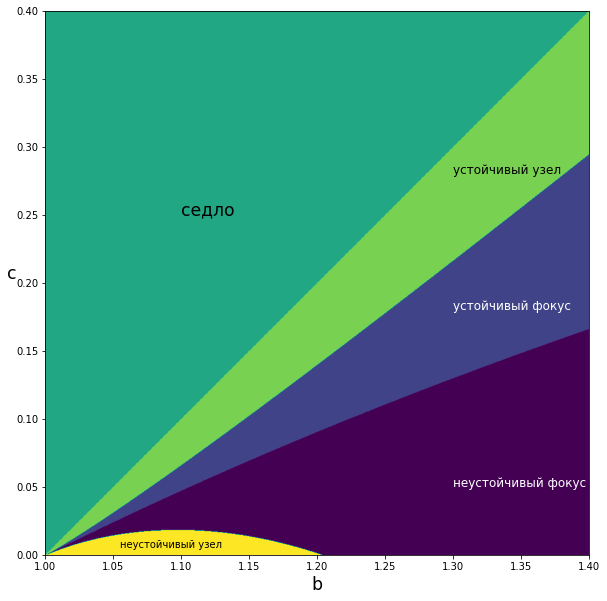

In [ ]:
print(num_to_portret)

fig, ax = plt.subplots(figsize=(6,6))

# ax.imshow(karta, cmap=plt.cm.Reds, interpolation='none', extent=[1,1.25,0,0.11])
im = ax.imshow(karta, extent=[1,1 + side,0,side])

ax.set_xlabel('b', size='xx-large')
ax.set_ylabel('c', rotation=0, size='xx-large')

for b, c, kwargs in [(1.1, 0.25, {'size':'xx-large'}),
                     (1.3, 0.28, {'size':'large'}),
                     (1.3, 0.18, {'color':'#fff', 'size':'large'}),
                     (1.3, 0.05, {'color':'#fff', 'size':'large'}),
                     (1.055, 0.005, {})]:
  discr = get_m2_discriminant(b, c)
  trA = get_m2_tr(b, c)
  ax.annotate(get_portret(discr, trA), (b, c), **kwargs)

# fig.colorbar(im, ax=ax)
fig.set_size_inches(10, 10)

# ax.set_title("Типы фазовых потртетов $M_2$")
fig.savefig("m2_portret_types.png")
fig.show()


portrets = ['']

for b in bs:
  portret = get_m2_portret(b, 0.1)
  if portrets[-1] != portret:
    portrets.append(portret)

print(portrets[1:])

$c=0.1$

$b:$

$(1, c+1) \rightarrow Седло$

$[c+1, \frac{c}{2(\sqrt2-1)}+1] \rightarrow устойчивый\ узел$

$(\frac{c}{2(\sqrt2-1)}+1, \frac{2}{1 - c}-1) \rightarrow устойчивый\ фокус$

$Центр$

$(\frac{2}{1 - c}-1, +\infty) \rightarrow неустойчивый\ фокус$

#Визуализация системы

###Метод Рунге-Кутта

$s_{k+1}=s_{k}+\dfrac{1}{6}[K_{1}+2K_{2}+2K_{3}+K_{4}]$

$s=(x, y)$

$(\dot x, \dot y)=f(t, s)$

$K_{1} = h f(t_k, s_k)$

$K_{2} = h f(t_k+\frac{h}{2}, s_k + \frac{K_{1}}{2})$

$K_{3} = h f(t_k+\frac{h}{2}, s_k + \frac{K_{2}}{2})$

$K_{4} = h f(t_k+h, s_k + K_{3})$

В нашем случае $f$ не зависит от $t$

$s_{k+1}=s_{k}+\dfrac{1}{6}[K_{1}+2K_{2}+2K_{3}+K_{4}]$

$s=(x, y)$

$(\dot x, \dot y)=f(s)$

$K_{1} = h f(s_k)$

$K_{2} = h f(s_k + \frac{K_{1}}{2})$

$K_{3} = h f(s_k + \frac{K_{2}}{2})$

$K_{4} = h f(s_k + K_{3})$

#Фазовые портреты

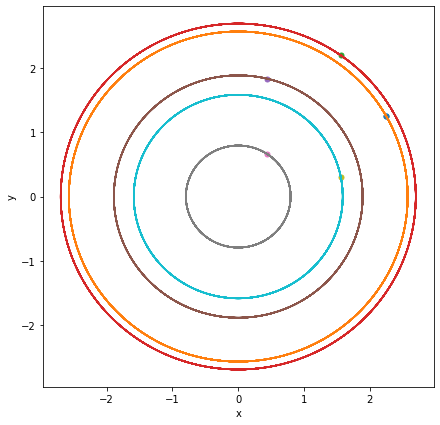

In [ ]:
plot_tracks(1.25 + get_circular_points(6), circle, 60000)

##Портрет 1

$a = 2;b \in (1, 1 + c);c = 0.1$

$M_0 - Saddle$

$M_1 - Stable\ Node$

$M_2\approx (20, -10.5)[b\approx 1+\frac{c}{2}] \Rightarrow \not \exists$

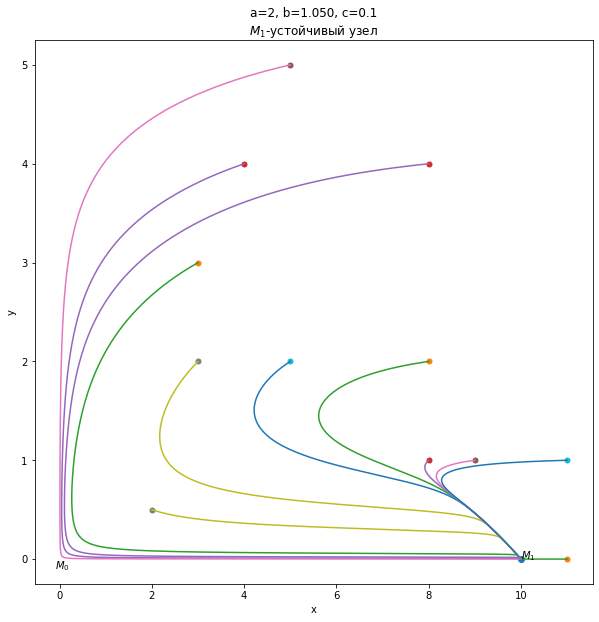

In [ ]:
a, c = 2, 0.1
b = 1 + c / 2

m0 = np.array([0, 0])
plt.annotate('$M_0$', m0 - 0.1)
m1 = get_m1(a, b, c)
plot_point(m1, '$M_1$', plt)

start_points = get_common_start_points()
plot_tracks(start_points, get_f(a, b, c), 100000)
plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-устойчивый узел')
plt.savefig("portret_1.png")
plt.show()

##Портрет 2

$a = 2;b = 1 + c;c = 0.1$

$M_0 - Saddle$

$M_2 = M_1 - Stable\ Node$

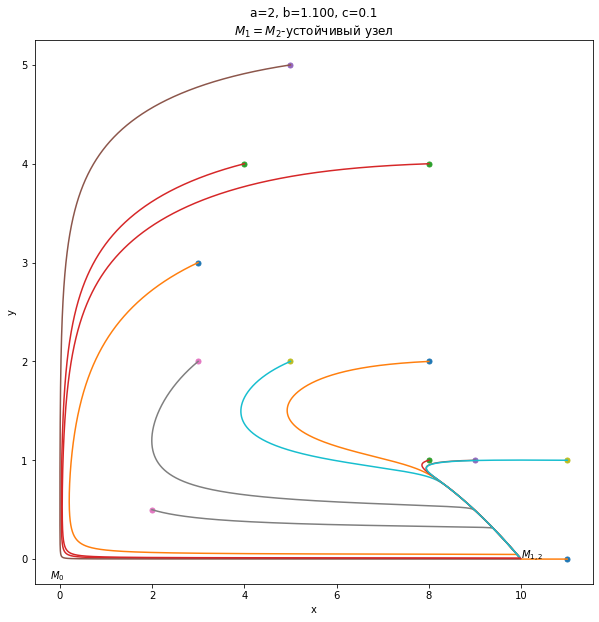

In [ ]:
a, c = 2, 0.1
b = 1 + c

m0 = np.array([0, 0])
plt.annotate('$M_0$', m0 - 0.2)
m1 = get_m1(a, b, c)
plt.annotate('$M_{1,2}$', m1)

start_points = get_common_start_points()
plot_tracks(start_points, get_f(a, b, c), 3000000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1=M_2$-устойчивый узел')
plt.savefig("portret_2.png")
plt.show()

##Портрет 3

$a = 2;b \in (1 + c, \frac{c}{2(\sqrt2-1)}+1];c = 0.1$

$M_1 - Saddle$

$M_2 - Stable\ Node$

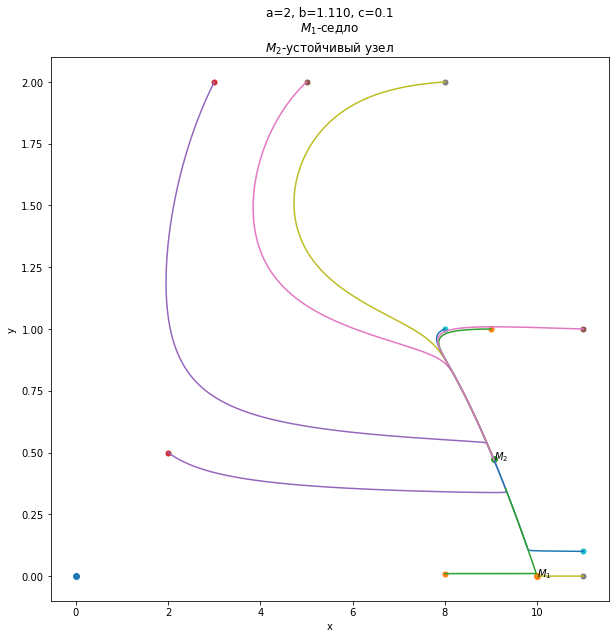

In [ ]:
a, c = 2, 0.1

b1 = c + 1
b2 = c / (2 * (2 ** 0.5 - 1)) + 1

b = (b1 + b2) / 2

plot_m_points(plt)

special = [[11, 0.1], [8, 0.01]]

start_points = get_common_start_points()[3:-1]
start_points = np.concatenate((start_points, np.array(special)))
plot_tracks(start_points, get_f(a, b, c), 500000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-седло\n$M_2$-устойчивый узел')
plt.savefig("portret_3_1.png")

plt.show()

##Портрет 4

$a = 2; b \in (\frac{c}{2(\sqrt2-1)}+1, \frac{2}{1 - c}-1); c = 0.1$

$M_2 - устойчивый\ фокус$

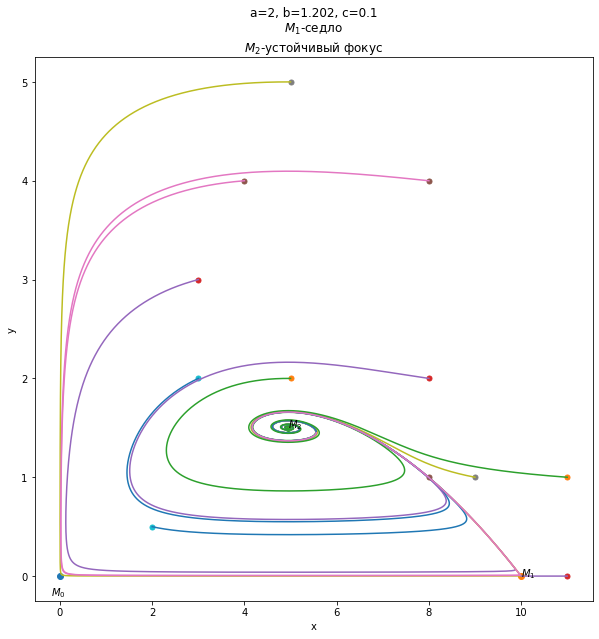

In [ ]:
a, c = 2, 0.1

b1 = c / (2 * (2 ** 0.5 - 1)) + 1
b2 = 2 / (1 - c) - 1

b = (b1 * 0.2 + b2 * 0.8)

plot_m_points(plt)

start_points = get_common_start_points()
plot_tracks(start_points, get_f(a, b, c), 100000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-седло\n$M_2$-устойчивый фокус')
plt.savefig("portret_4.png")

plt.show()

##Портрет 5

$a = 2; b = \frac{2}{1 - c}-1; c = 0.1$

$M_2 - Center$

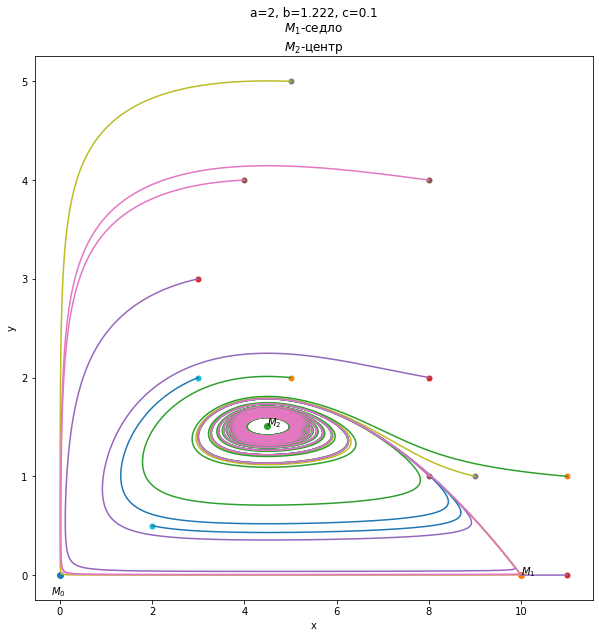

In [ ]:
a, c = 2, 0.1

b = 2 / (1 - c) - 1

plot_m_points(plt)

start_points = get_common_start_points()
plot_tracks(start_points, get_f(a, b, c), 500000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-седло\n$M_2$-центр')
plt.savefig("portret_5.png")

plt.show()

##Портрет 6

$a = 2; b \in (\frac{2}{1 - c}-1, +\infty); c = 0.1$

$M_2 - неустойчивый\ фокус$

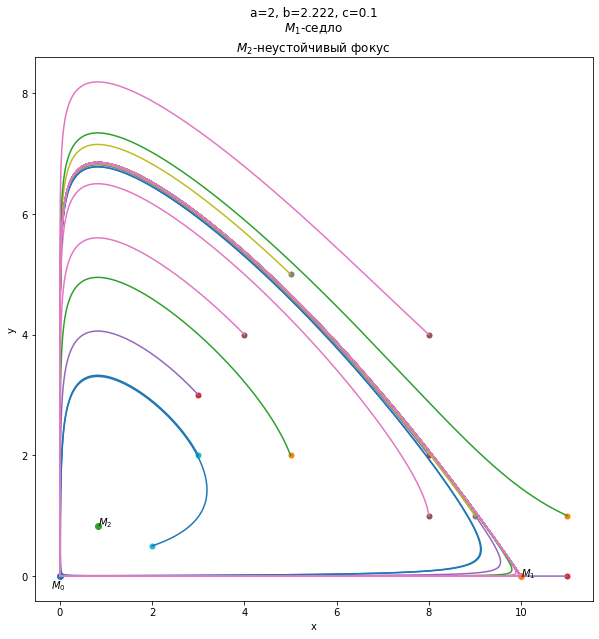

In [ ]:
a, c = 2, 0.1

b = 2 / (1 - c)

plot_m_points(plt)

start_points = get_common_start_points()
plot_tracks(start_points, get_f(a, b, c), 100000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-седло\n$M_2$-неустойчивый фокус')
plt.savefig("portret_6.png")

plt.show()

##Портрет 7

$a = 2; b = 1.1; c = 0.01$

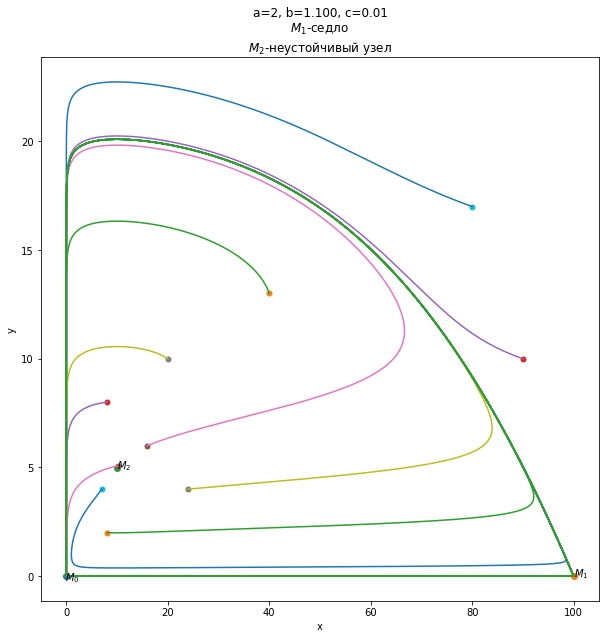

In [ ]:
a, c = 2, 0.01

b = 1.1

plot_m_points(plt)
make_legend(a, b, c)

start_points = [(4 * i, 10 - i) for i in range(2, 7, 2)]
start_points += [[80, 17], [40, 13], [90, 10]]
start_points += [get_m2(a, b, c) + 0.1, [20, 10], [7, 4], [8, 2]]

start_points = np.array(start_points)
plot_tracks(start_points, get_f(a, b, c), 1000000)

plt.title(f'a={a}, b={b:.3f}, c={c}\n$M_1$-седло\n$M_2$-неустойчивый узел')
plt.savefig("portret_7.png")

plt.show()

#A

###$M_0(0,0)$

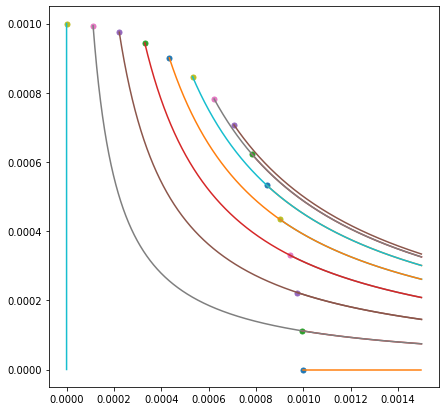

In [ ]:
m_0 = np.array([0, 0])

steps=10000
start_points = m_0 + get_circular_points(15, 0.001, np.pi / 2)
for start_point in start_points:
    track = get_trace(start_point, get_f(2, 2, 0.1), steps)
    track = track[track[:,0] <= 0.0015]
    plt.plot(*track[0], marker='o', markersize=5)
    plt.plot(track[:,0], track[:,1])

plt.show()

###$M_1(\frac{1}{c},0)$

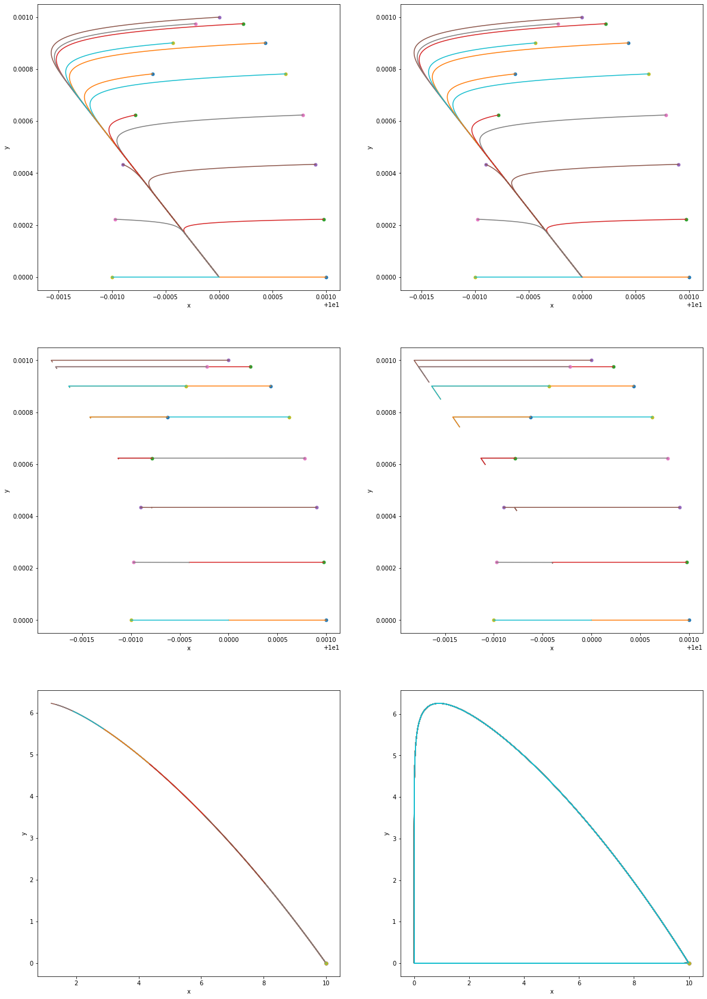

In [ ]:
a, c = 2, 0.1
b1 = c + 1

abcs = [
        (a, (1 + b1) / 2, c, 1000),
        (a, b1, c, 4000),
        (a, b1 + 1, c, 100)
        ]

fig, axs = plt.subplots(len(abcs), 2)

for i, (a, b, c, n) in enumerate(abcs):
  plot_m1_tracks(a, b, c, n, axs[i, 0])
  plot_m1_tracks(a, b, c, n * 10, axs[i, 1])

fig.set_size_inches(20, 10 * len(abcs))
fig.show()

###$M_2(\frac{1}{b-1}, \frac{(b-c-1)b}{a(b-1)^2})$

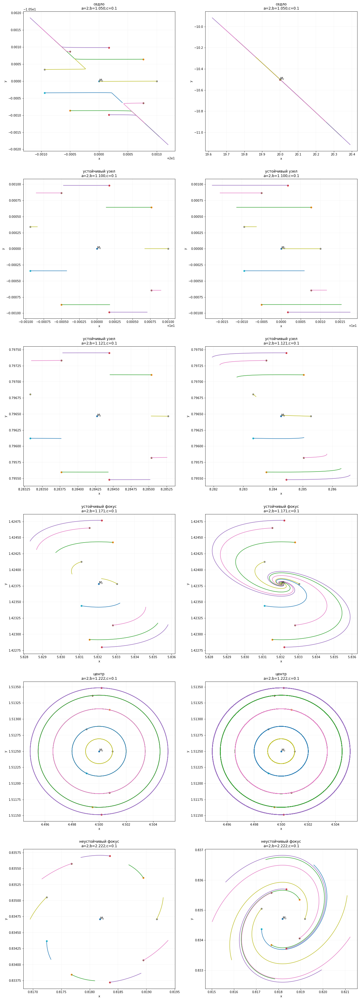

In [ ]:
a, c = 2, 0.1

b1 = c + 1
b2 = c / (2 * (2 ** 0.5 - 1)) + 1
b3 = 2 / (1 - c) - 1

abcs = [
        (a, (1 + b1) / 2, c, 40000),
        (a, b1, c, 400),
        # (a, (b1 + b2) / 2, c, 400), # still node
        (a, b2, c, 400), # still node
        (a, (b2 + b3) / 2, c, 4000),
        (a, b3, c, 40000),
        (a, b3 + 1, c, 560),
        ]

fig, axs = plt.subplots(len(abcs), 2)

for i, (a, b, c, n) in enumerate(abcs):
  plot_m2_tracks(a, b, c, n, axs[i, 0])
  plot_m2_tracks(a, b, c, n * 10, axs[i, 1])

fig.set_size_inches(20, 10 * len(abcs))
fig.savefig('lotsOfPortrets.png')
fig.show()

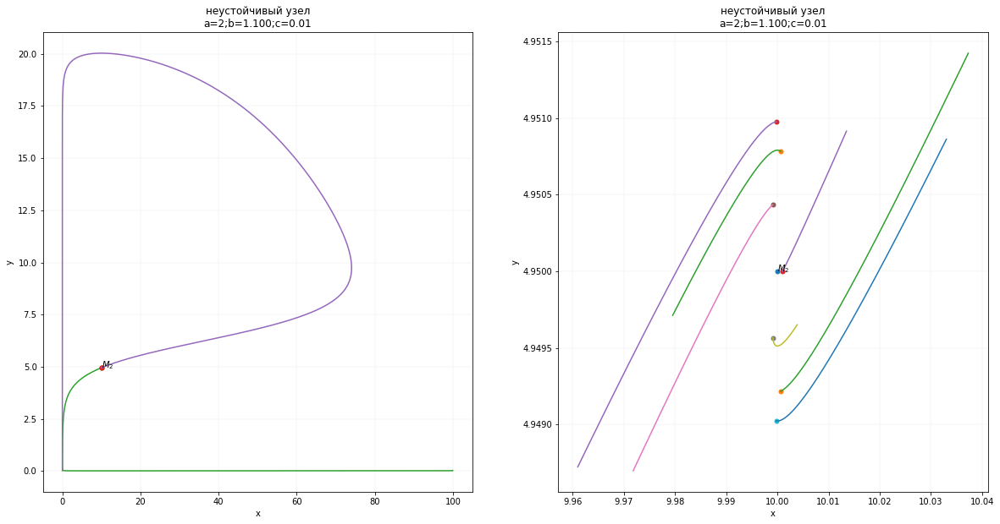

In [ ]:
a, b, c = (2, 1.1, 0.01)
fig, axs = plt.subplots(1, 2)
plot_m2_tracks(a, b, c, 40000, axs[0], 3)
plot_m2_tracks(a, b, c, 4100, axs[1], 8)
fig.set_size_inches(20, 10)
fig.show()

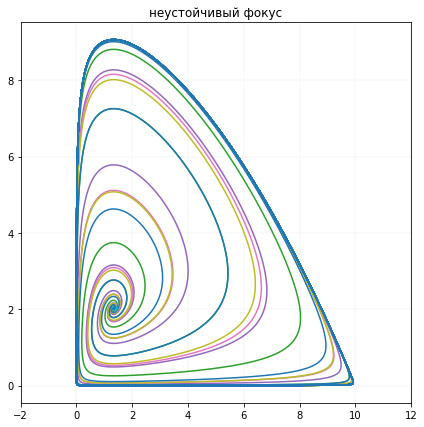

In [ ]:
plot_m2_tracks(1, 1.75, 0.1, 50000)

#Циклы

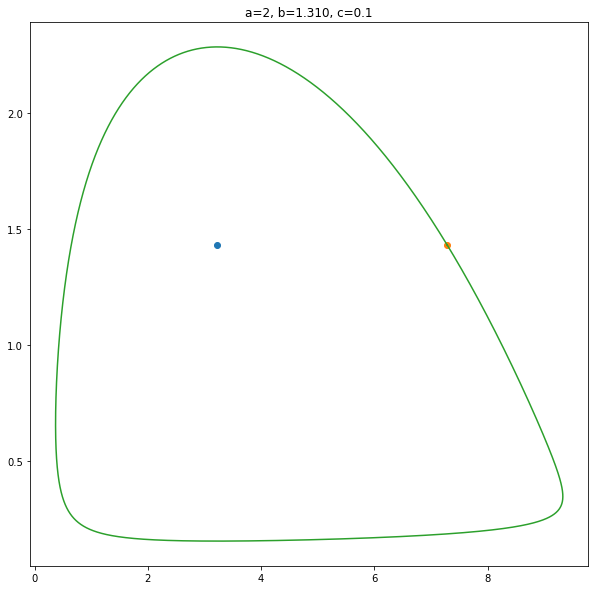

In [ ]:
a, b, c = 2, 1.31, 0.1

plt.title(f'a={a}, b={b:.3f}, c={c}')

plt.savefig('cycle_3.png')

plot_m2_cycle(a, b, c)

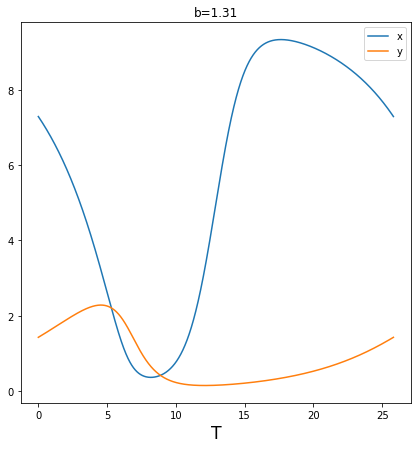

In [ ]:
h = 1e-3
cycle = get_m2_cycle(2, 1.31, 0.1, h=h)
t = np.linspace(0, len(cycle) * h, len(cycle))
plt.plot(t, cycle[:,0], label='x')
plt.plot(t, cycle[:,1], label='y')
plt.legend()
plt.title(f"b={1.31}")
plt.xlabel('T', size='xx-large')
plt.savefig('small_cycle.png')

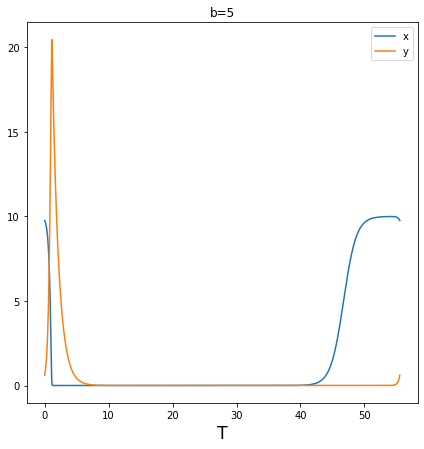

In [ ]:
cycle = get_m2_cycle(2, 5, 0.1, h=h)
t = np.linspace(0, len(cycle) * h, len(cycle))
plt.plot(t, cycle[:,0], label='x')
plt.plot(t, cycle[:,1], label='y')
plt.legend()
plt.title(f"b={5}")
plt.xlabel('T', size='xx-large')
plt.savefig('big_cycle.png')

0 0,0 1,1 0,1 1,

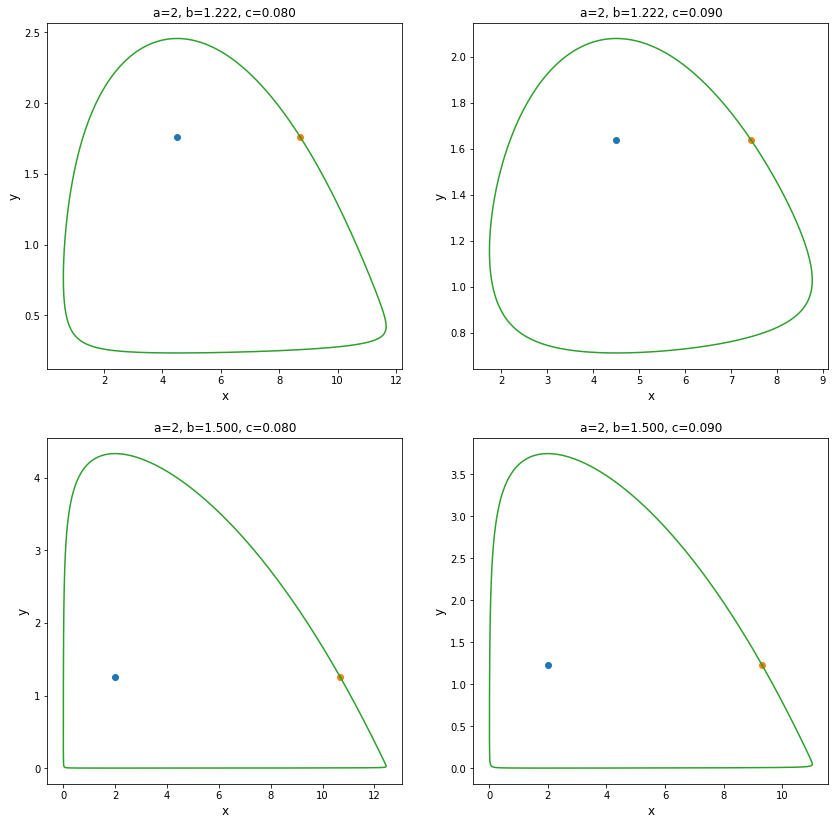

In [ ]:
a, c = 2, 0.1

cs = np.linspace(0.08, 0.09, 2)
bs = [1.222, 1.5]

fig, axs = plt.subplots(len(bs), len(cs))


for i, b in enumerate(bs):
  for j, c in enumerate(cs):
    print(i, j, end=',')
    axs[i, j].set_title(f'a={a}, b={b:.3f}, c={c:.3f}')
    axs[i, j].set_xlabel('x', size='large')
    axs[i, j].set_ylabel('y', size='large')
    plot_m2_cycle(a, b, c, axs[i, j])

fig.set_size_inches(14, 14)
fig.savefig('four_cycles.png')
fig.show()

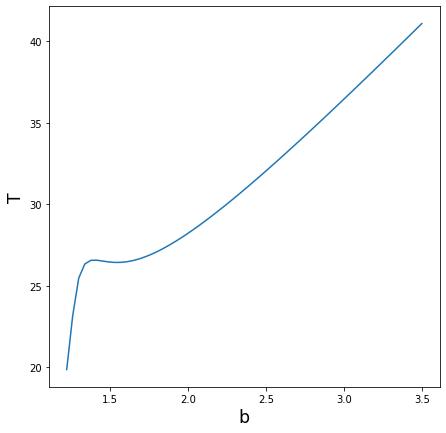

In [ ]:
# 5 minutes
a, c = 2, 0.1
b_ = 2/(1-c) - 1

plot_cycle_period(a, c, b_, 3.5, 60)
plt.savefig('complete_period.png')

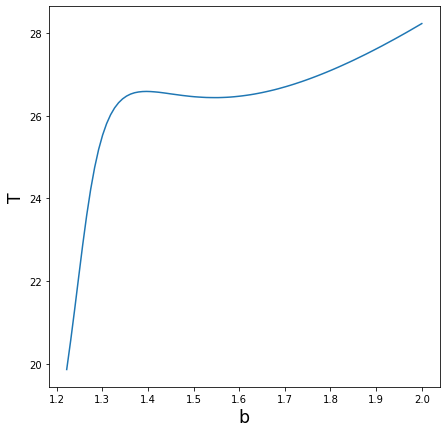

In [ ]:
plot_cycle_period(a, c, b_, 2, 90)
plt.savefig('local_period.png')

#Бифуркации

5
21
101


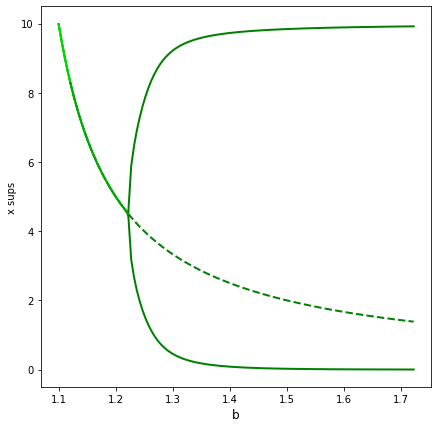

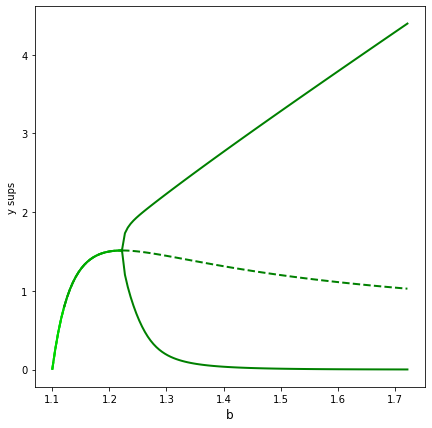

In [ ]:
def plot_sups():
  a, c = 2, 0.1
  b1 = c + 1
  b2 = c / (2 * (2 ** 0.5 - 1)) + 1
  b3 = 2 / (1 - c) - 1
  delta = 0.00001
  cool_bs = [1, b1, b2, b3, b3 + 0.5][1:]
  bss = []
  for i in range(1, len(cool_bs)):
    start, end = cool_bs[i - 1] + delta, cool_bs[i] - delta
    n = int(1 + round((end - start) * 2e2))
    print(n)
    bss.append(np.linspace(start, end, n))

  # fig, axs = plt.subplots(1, 2)
  data = []
  
  for color, bs in enumerate(bss):
    # print(bs[0])
    # print(len(bs))
    data.append(get_sups(a, bs, c, 1000000))
    # x_mins, x_ms, x_maxs = get_sups(a, bs, c, 1000000)
  
  for i in range(2):
    for k, (x_mins, x_ms, x_maxs) in enumerate(data):
      color = (0, 1 - (k + 1) / (2 * len(bss)), 0)
    
      # axs[i].plot(bs, x_ms[:,i], '--', color=color, lw=2)
      # axs[i].plot(bs, x_mins[:,i], color=color, lw=2)
      # axs[i].plot(bs, x_maxs[:,i], color=color, lw=2)
      # axs[i].set_ylabel('xy'[i] + ' sups')
      # axs[i].set_xlabel('b', size='large')
      plt.plot(bss[k], x_ms[:,i], '--', color=color, lw=2)
      plt.plot(bss[k], x_mins[:,i], color=color, lw=2)
      plt.plot(bss[k], x_maxs[:,i], color=color, lw=2)
    
    plt.ylabel('xy'[i] + ' sups')
    plt.xlabel('b', size='large')

    plt.savefig('xy'[i] + '_sups.png')
    plt.show()
    

    
  # dimention = 'xy'[dimention]
  # plt.ylabel(f'{dimention} sups')
  # fig.set_size_inches(20, 10)
  # fig.savefig('sups.png')
  # fig.show()

plot_sups()

#Стохастика

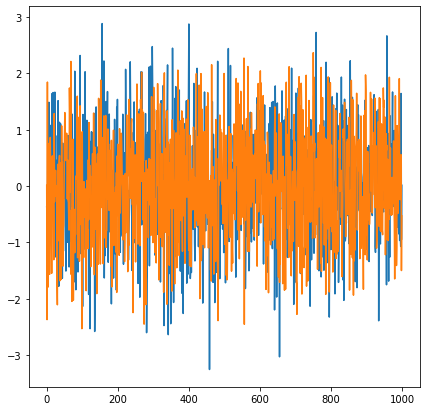

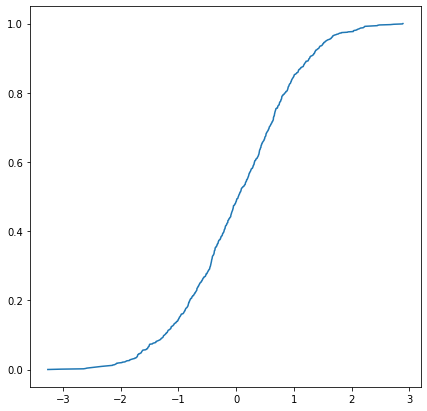

In [ ]:
n = 1000
es, qs = [], []

for i in range(n):
  e, q = rand_dxdy()
  es.append(e)
  qs.append(q)

plt.plot(es)
plt.plot(qs)
plt.show()

es.sort()
plt.plot(es, np.linspace(0, 1, len(es)))
plt.show()

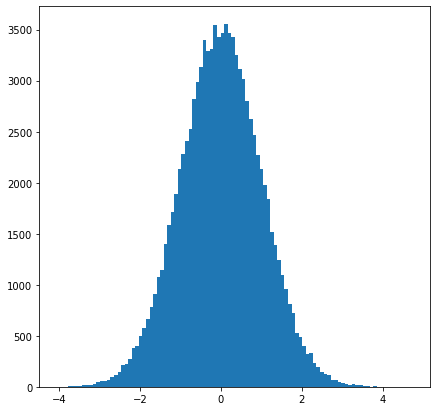

In [ ]:
plt.hist(es, bins=100)
plt.show()

###Необычно

In [ ]:
?get_stochastic_trace

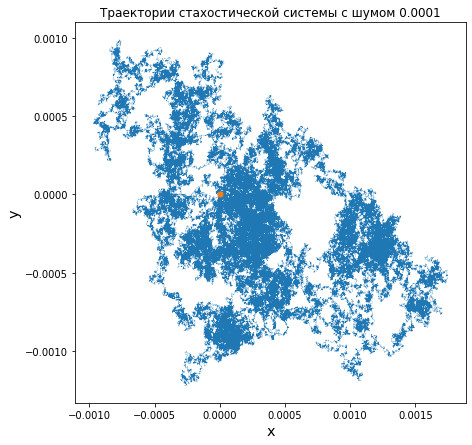

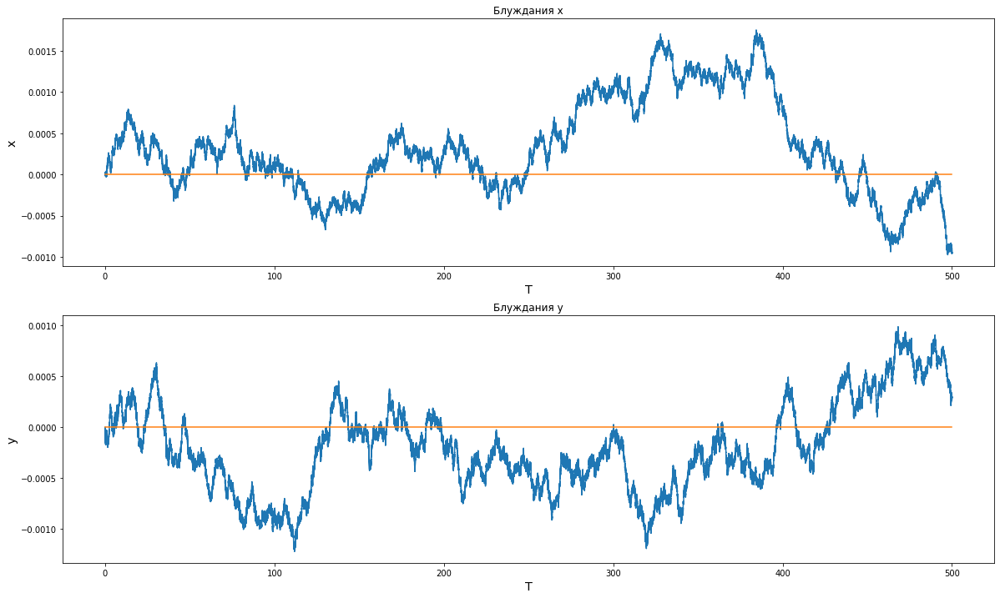

In [ ]:
@njit
def zero(*args):
  return np.array([0, 0])

plot_stochastic_traces(np.array([0, 0]), zero, steps=500000)

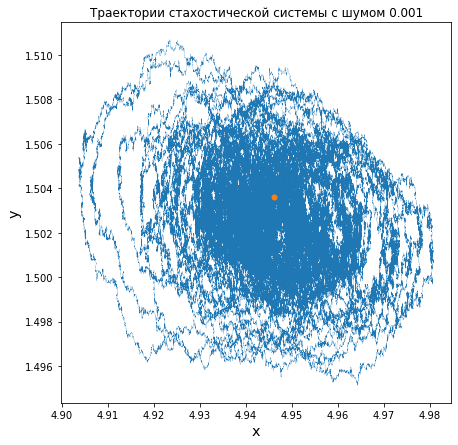

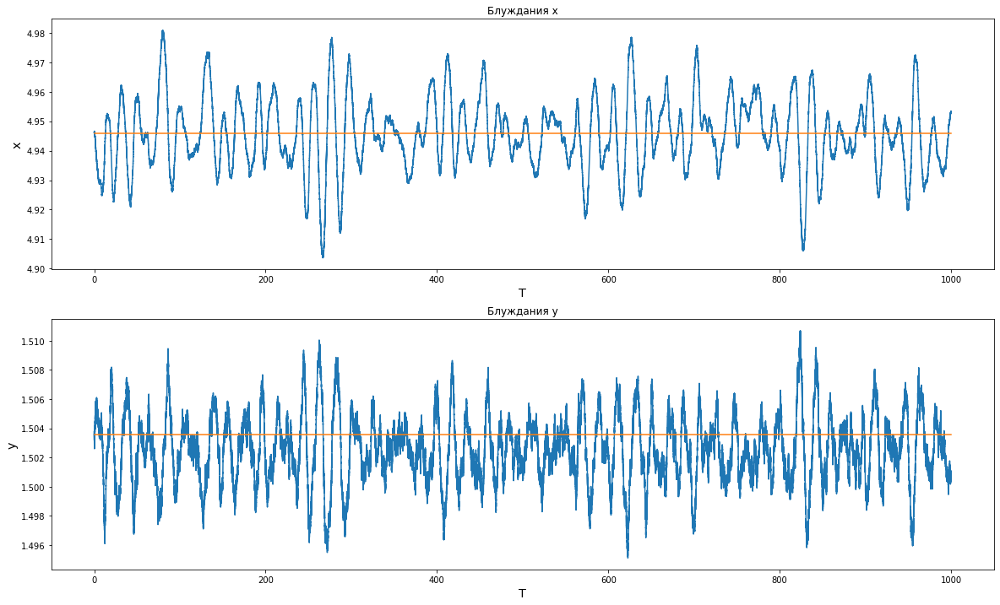

In [ ]:
a, b, c = 2, 1.21, 0.1
b1 = c + 1
b2 = c / (2 * (2 ** 0.5 - 1)) + 1
b3 = 2 / (1 - c) - 1

b_node = (b2 + b1) / 2
b_focus = (b2 * 0.9 + b3 *0.1)

plot_stochastic_m2(a, b3 - 0.02, c, steps=1000000)

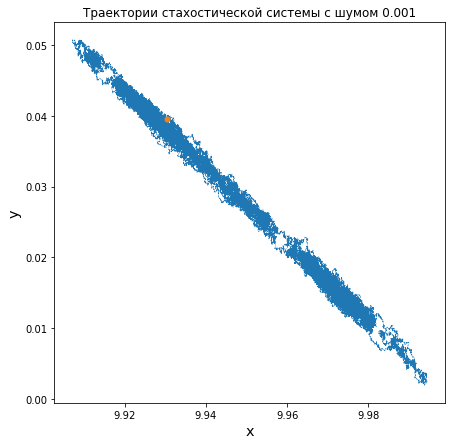

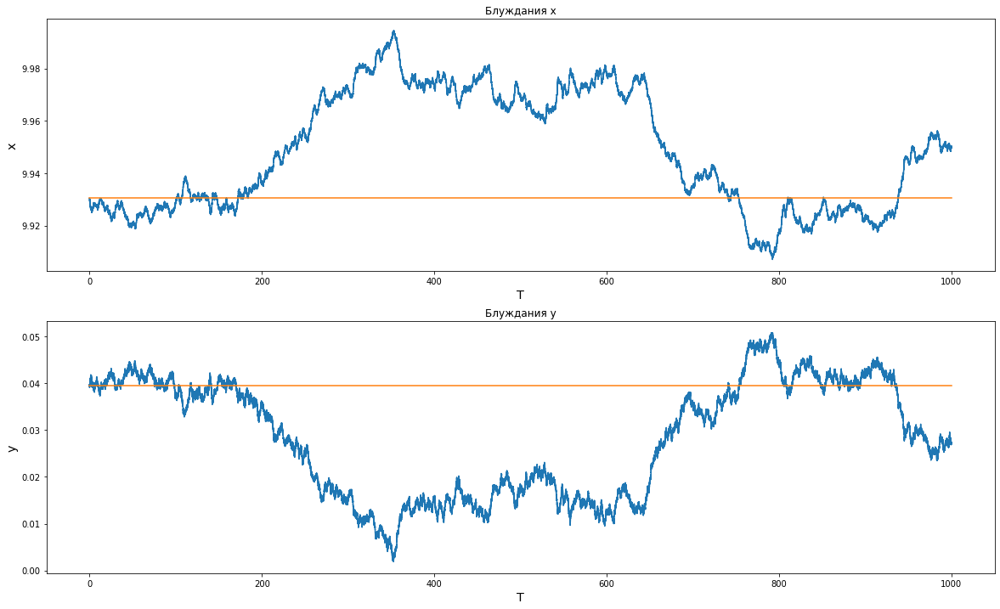

In [ ]:
plot_stochastic_m2(a, b2 - 0.02, c, steps=1000000)

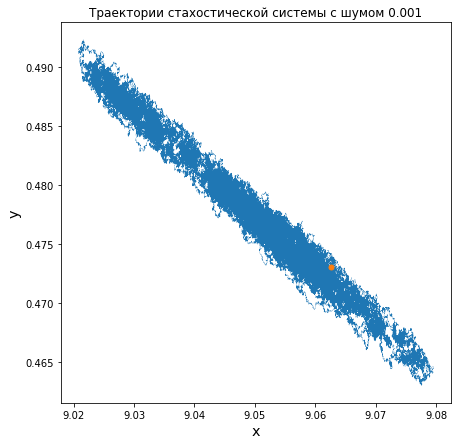

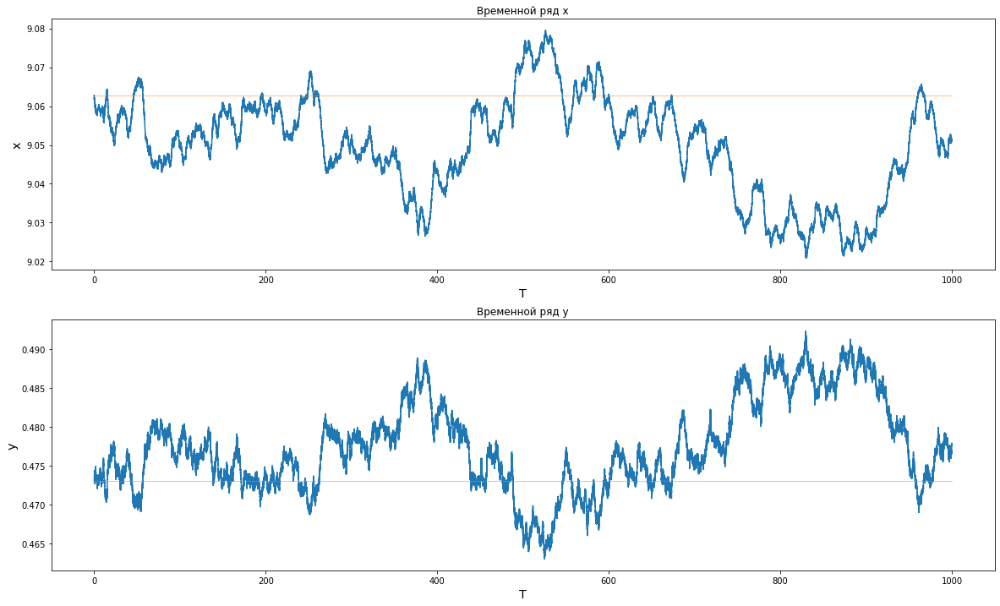

In [ ]:
plot_stochastic_m2(a, b_node, c, steps=1000000)

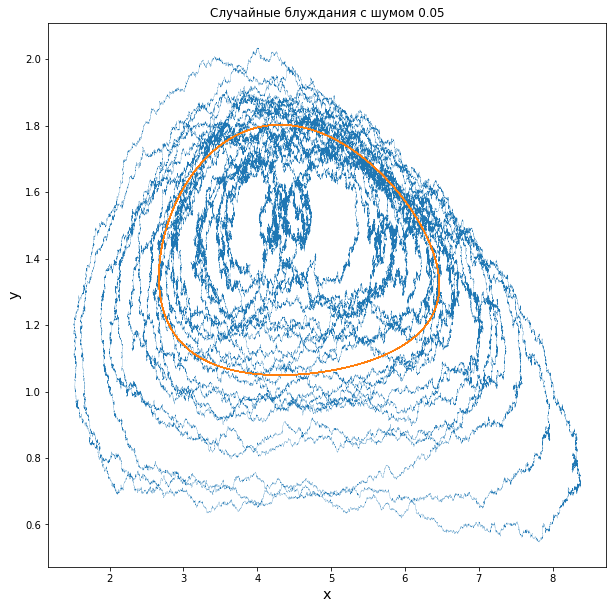

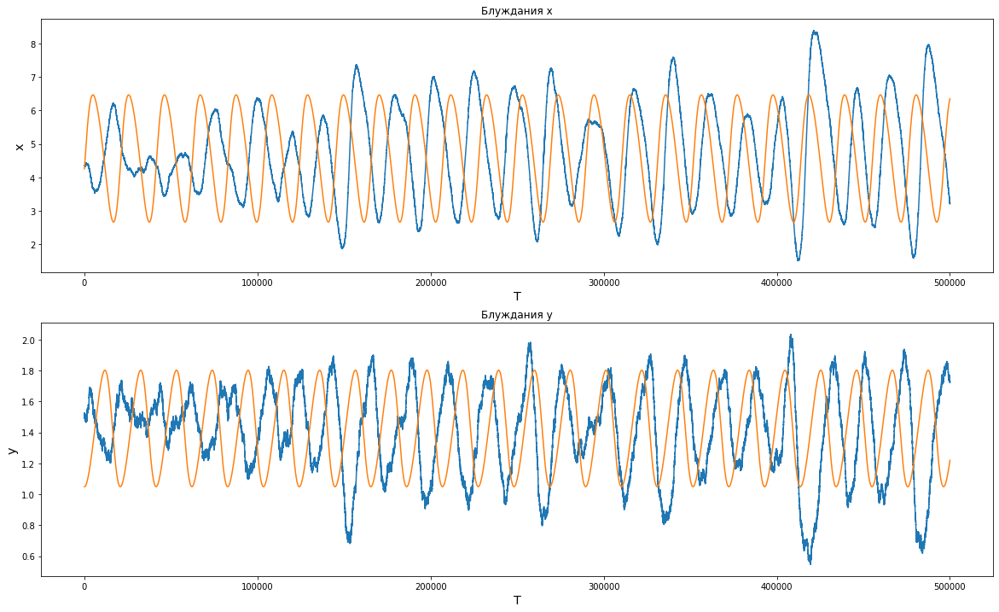

In [ ]:
a, c = 2, 0.1
b = 2/(1-c) - 1 + 1e-2

plot_stochastic_m2(a, b, c, 1e-3, 5e-2, 10000000)

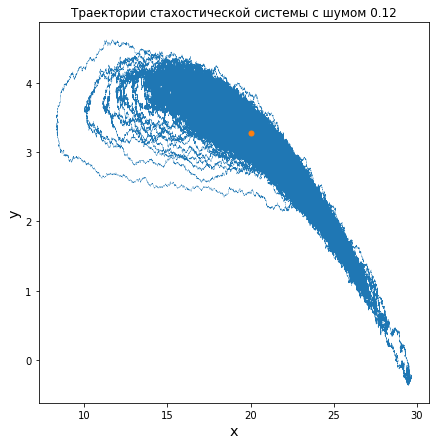

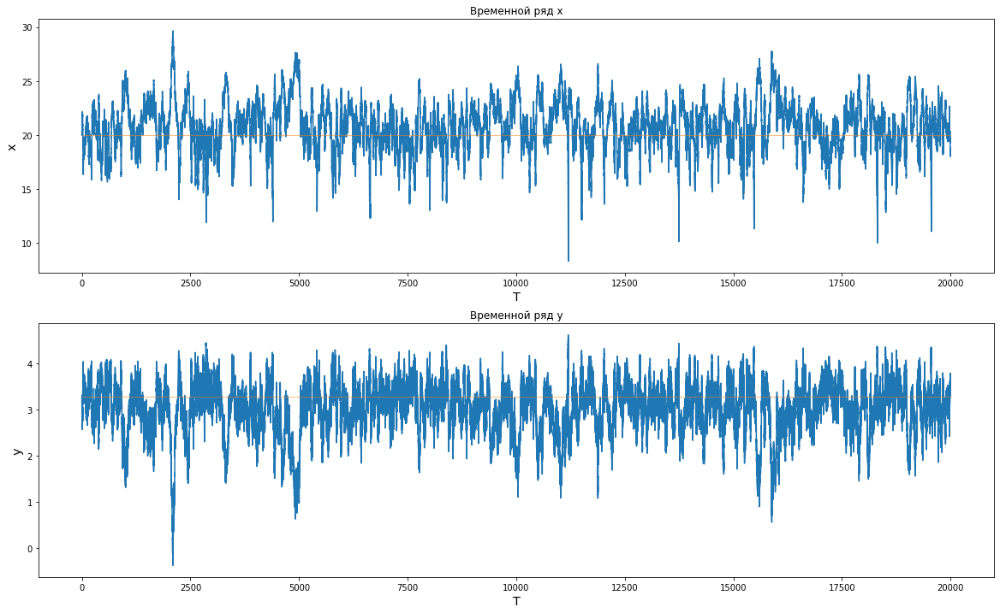

In [ ]:
a, b = 2, 1.05
c = 1 - 2 / (b + 1) + 1e-2

plot_stochastic_m2(a, b, c, 1e-3, 12e-2, 20000000)

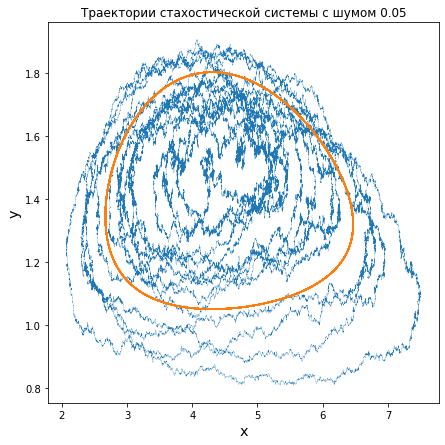

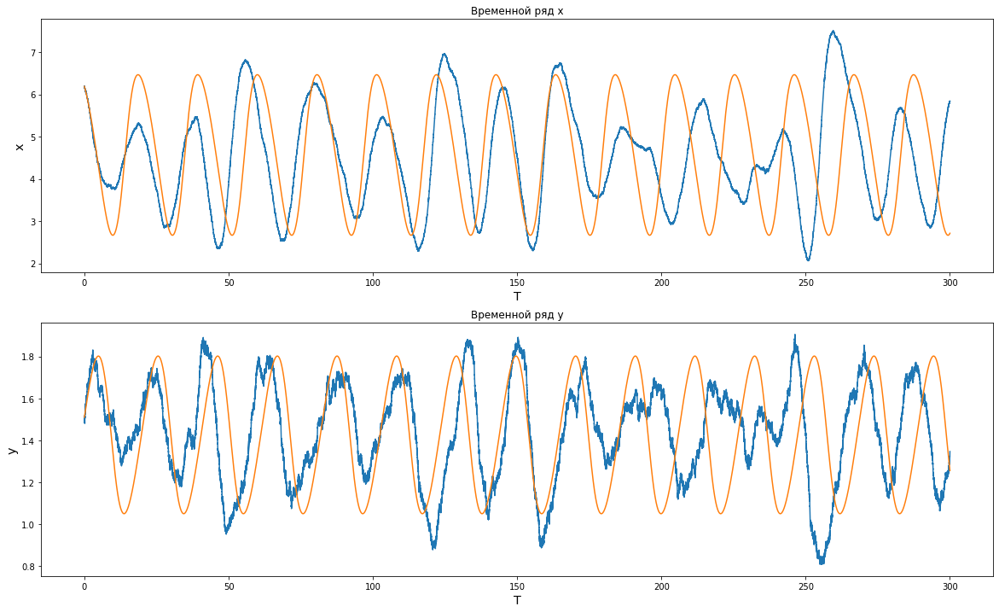

In [ ]:
a, c = 2, 0.1
b = 2/(1-c) - 1 + 1e-2

h = 1e-3
n = 300000
eps=5e-2

m2 = get_m2(a, b, c)
f_abc = get_f(a, b, c)

point = find_m2_cycle_point(m2, f_abc)
cycle = get_trace(point, f_abc, n, h)
stoc_cycle = get_stochastic_trace(point, f_abc, h, eps, n)

plt.title(f"Траектории стахостической системы с шумом {eps}")
plt.xlabel("x", size='x-large')
plt.ylabel('y', size='x-large')
plt.plot(stoc_cycle[:,0], stoc_cycle[:,1], lw=0.2)
plt.plot(cycle[:,0], cycle[:,1])
plt.savefig("stoch_cycle.png")
plt.show()

fig, axs = plt.subplots(2)

t = np.linspace(0, n * h, n)
for i in range(2):
  axs[i].plot(t, stoc_cycle[:,i])
  axs[i].plot(t, cycle[:,i])
  axs[i].set_title("Временной ряд " + 'xy'[i])
  axs[i].set_xlabel("T", size='x-large')
  axs[i].set_ylabel('xy'[i], size='x-large')

fig.set_size_inches(20, 12)
fig.savefig("stochastic_cycle_coord.png")

plt.show()

##Cov

In [ ]:
@njit
def get_cov_matrix_singular(track):
  xs = track[:,0]
  ys = track[:,1]
  x_mean = xs.mean()
  y_mean = ys.mean()
  a_11 = ((xs - x_mean) ** 2).mean()
  a_21 = a_12 = ((xs - x_mean) * (ys - y_mean)).mean()
  a_22 = ((ys - y_mean) ** 2).mean()

  tr = a_11 + a_22
  det = a_11 * a_22 - a_12 * a_21
  discr_2 = tr ** 2 - 4 * det
  discr = discr_2 ** 0.5

  return (tr + discr) / 2, (tr - discr) / 2

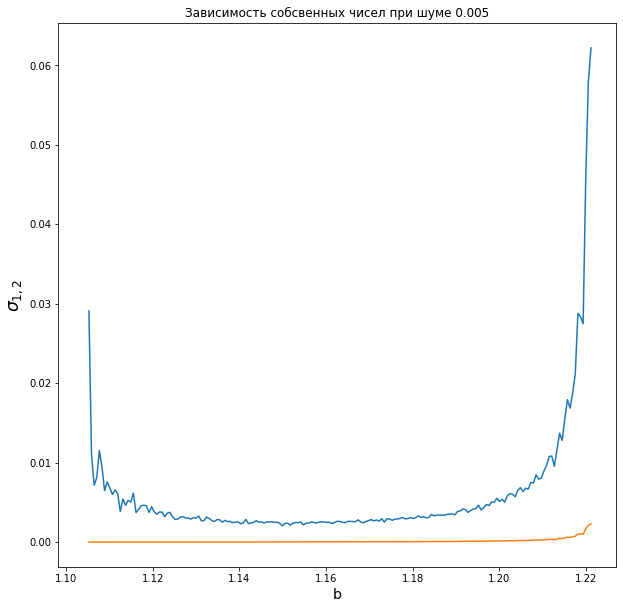

In [ ]:
a, c = 2, 0.1
b1 = c + 1
b2 = 2/(1-c) - 1
delta = 1e-3
bs = np.linspace(b1 + delta, b2 - delta, 100)

eps=0.005


l1s, l2s = [], []

for b in bs:
  m2 = get_m2(a, b, c)
  f_abc = get_f(a, b, c)
  stoc = get_stochastic_trace(m2, f_abc, 1e-3, eps, n=10000000)
  
  l1, l2 = get_cov_matrix_singular(stoc)
  
  l1s.append(l1)
  l2s.append(l2)

plt.plot(bs, l1s)
plt.plot(bs, l2s)

plt.title(f"Зависимость собсвенных чисел при шуме {eps}")
plt.xlabel('b', size='x-large')
plt.ylabel('$\sigma_{1,2}$', size='xx-large')

plt.savefig("singular.png")
plt.show()

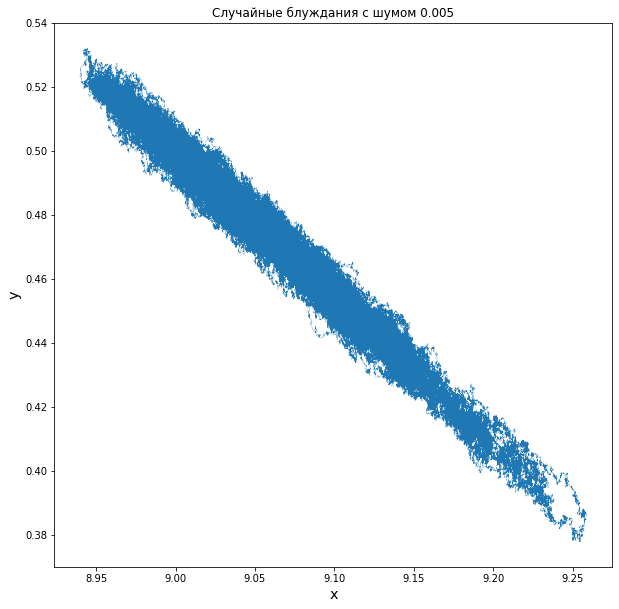

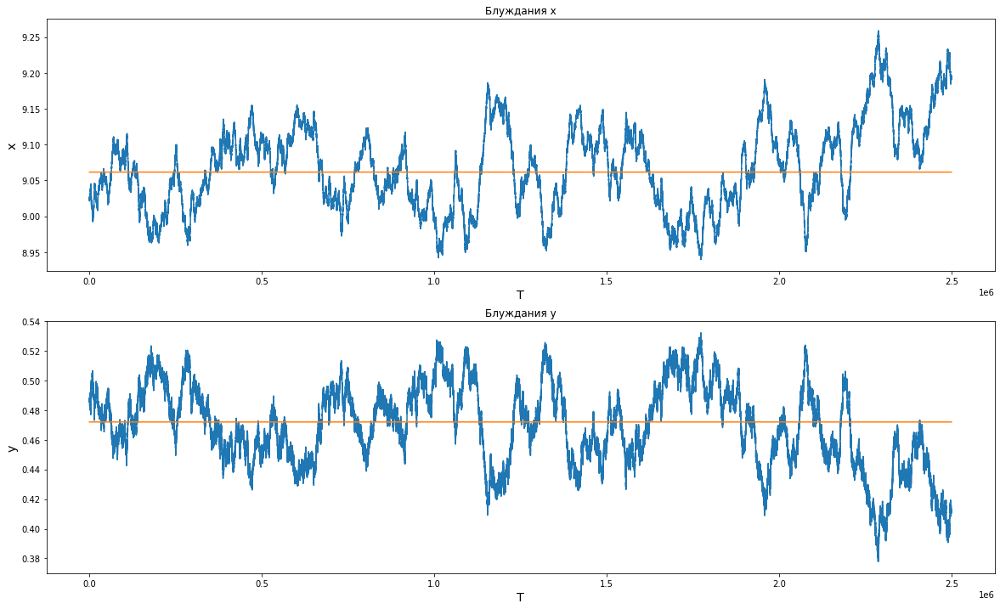

In [ ]:
a, c = 2, 0.1
b1 = c + 1
b2 = c / (2 * (2 ** 0.5 - 1)) + 1
b = (b1 + b2) / 2

plot_stochastic_m2(a, b, c, 1e-3, 0.005, 5000000)

#Animation!

In [ ]:
def create_png(a, b, c, filename):
  m0 = np.array([0, 0])
  plt.annotate('$M_0$', m0 - 0.1)
  m1 = get_m1(a, b, c)
  plot_point(m1, '$M_1$', plt)
  m2 = get_m2(a, b, c)

  start_points = list(get_common_start_points())

  if m2[1] >= 0:
    plot_point(m2, '$M_2$', plt)
    start_points += [m2 + 0.001]

  start_points = np.array(start_points)
  
  # plt.ylim(-.5, 8)
  plot_tracks(start_points, get_f(a, b, c), 100000)

  plt.title(f'a={a}, b={b:.3f}, c={c:.3F}')
  plt.savefig(filename)
  plt.close()

In [ ]:
import os
import imageio
from IPython.display import Image

!mkdir gif/

def build_gif(gif_name, filenames):
  with imageio.get_writer(gif_name, mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
          
  # Remove files
  for filename in set(filenames):
      os.remove(filename)
  
  return Image(open(gif_name,'rb').read())

mkdir: cannot create directory ‘gif/’: File exists


0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 

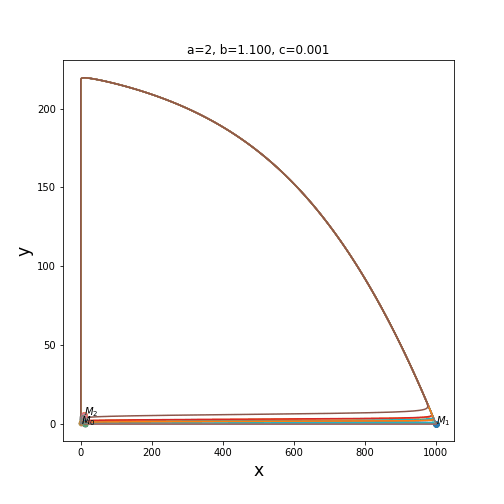

In [ ]:
a, b = 2, 1.1
# b = 1 + c / 2
cs = np.linspace(0.001, 0.1, 120)

filenames = []
for i, c in enumerate(cs):
  print(i, end=' ')

  filename = f'gif/{i}.png'
  filenames.append(filename)

  create_png(a, b, c, filename)

build_gif("c_change.gif", filenames)

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 

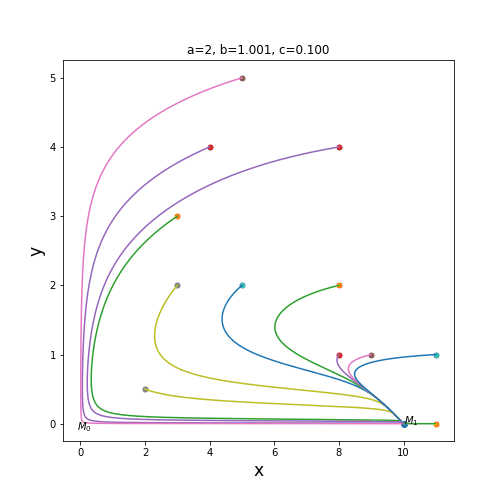

In [ ]:
a, c = 2, 0.1
# b = 1 + c / 2
bs = np.linspace(1.001, 2, 120)

filenames = []
for i, b in enumerate(bs):
  print(i, end=' ')

  filename = f'gif/{i}.png'
  filenames.append(filename)

  create_png(a, b, c, filename)

build_gif("b_change.gif", filenames)

0 
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 
31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 
61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 
91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 

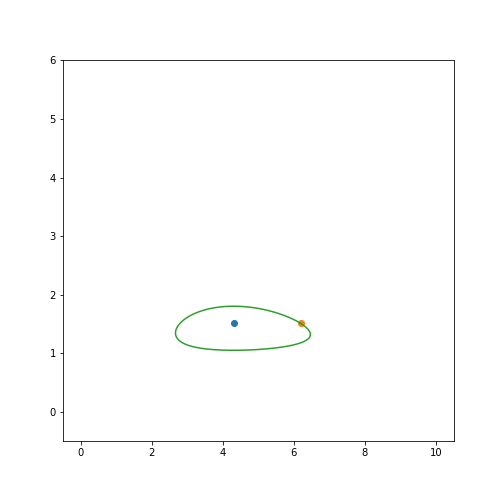

In [ ]:
a, c = 2, 0.1
# b = 1 + c / 2
bs = np.linspace(2 / (1 - c) - 1 + 0.01, 1.3, 120)

filenames = []
for i, b in enumerate(bs):
  print(i, end=' ')
  if (i % 30 == 0):
    print()

  filename = f'gif/{i}.png'
  filenames.append(filename)

  plt.xlim(-.5, 10.5)
  plt.ylim(-.5, 6)
  plot_m2_cycle(a, b, c)
  plt.savefig(filename)
  plt.close()

gif_name='fast_cycles.gif'
build_gif(gif_name, filenames)

0 
1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 

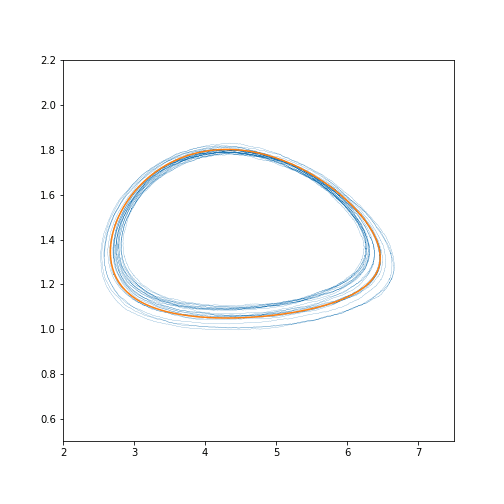

In [ ]:
a, c = 2, 0.1
b = 2/(1-c) - 1 + 1e-2
# b = 1 + c / 2
bs = np.linspace(b, 1.3, 30)

filenames = []
m2 = get_m2(a, b, c)
f_abc = get_f(a, b, c)
cycle = get_m2_cycle(a, b, c)

for i, _ in enumerate(bs):
  print(i, end=' ')
  if (i % 30 == 0):
    print()

  filename = f'gif/{i}.png'
  filenames.append(filename)

  plt.xlim(2, 7.5)
  plt.ylim(0.5, 2.2)
  steps = 1000000
  trace = get_stochastic_trace(cycle[0], f_abc, 1e-3, 5e-3, steps)[steps // 2:]
  xs, ys = trace[:,0], trace[:,1]
  plt.plot(xs, ys, lw=1/5)
  plt.plot(cycle[:,0], cycle[:,1])
  plt.savefig(filename)
  plt.close()

gif_name='stoc_cycle.gif'
build_gif(gif_name, filenames)

In [ ]:
from  matplotlib import rc
rc('animation', html='jshtml')

In [ ]:
def get_bounds(x):
  x_min, x_max = min(x), max(x)
  width = x_max - x_min
  return x_min - width / 20, x_max + width / 20

[]0[[]0[[]0[]1[]2[]3[]4[]5[]6[]7[]8[]9[]10[]11[]12[]13[]14[]15[]16[]17[]18[]19[]20[]21[]22[]23[]24[]25[]26[]27[]28[]29[]30[]31[]32[]33[]34[]35[]36[]37[]38[]39[]40[]41[]42[]43[]44[]45[]46[]47[]48[]49[]50[]51[]52[]53[]54[]55[]56[]57[]58[]59[]60[]61[]62[]63[]64[]65[]66[]67[]68[]69[]70[]71[]72[]73[]74[]75[]76[]77[]78[]79[]80[]81[]82[]83[]84[]85[]86[]87[]88[]89[]90[]91[]92[]93[]94[]95[]96[]97[]98[]99[

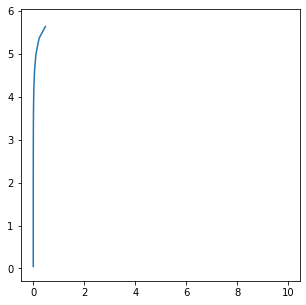

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

frames = 1000
steps = 10 
xy = get_trace(m_2 + np.array([0.01, 0.01]), get_v, frames * steps)
x=xy[::steps,0]
y=xy[::steps,1]

fig, ax = plt.subplots()
line, = ax.plot(x, y)
x_min, x_max = get_bounds(x)
y_min, y_max = get_bounds(y)
line.axes.axis([x_min, x_max, y_min, y_max])

def update(num, x, y, line):
    logProgress(num \\ 10)
    # line.set_data(x[:num], y[:num])
    lower_bound = max(0, num-50)
    line.set_data(x[lower_bound:num], y[lower_bound:num])
    # line.axes.axis([-0.1, 10, -0.1, 6])
    return line,

ani = animation.FuncAnimation(fig, update, len(x), fargs=[x, y, line],
                              interval=25, blit=True)
ani

In [ ]:
def get_xs_ys(a, b, c):
  m_2 = np.array([1/(b - 1), (b-c-1) * b / (a * (b - 1) ** 2)])
  track = get_trace(m_2 + delta, get_f(a, b, c), 1000000)
  return track[:,0], track[:,1]

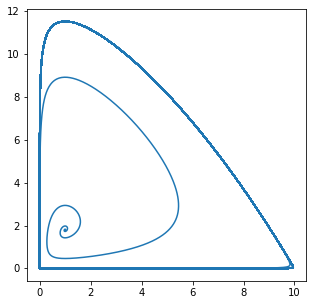

In [ ]:
x, y = get_xs_ys(a, 2, c)
plt.plot(x, y)

[]0[[]0[]1[]2[]3[]4[]5[]6[]7[]8[]9[]10[]11[

[]0[

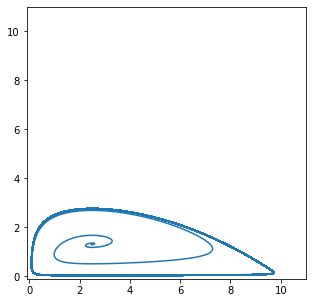

In [ ]:
fig, ax = plt.subplots()
ax.set(xlim=(-.1, 11), ylim=(-.1, 11))

frames = 120
a, c = 2, 0.1
bs = np.linspace(1.4, 5, frames)
x, y = get_xs_ys(a, bs[0], c)
line, = ax.plot(x, y)


def animate(i):
  logProgress(i)
  x, y = get_xs_ys(a, bs[i], c)
  # line, = ax.plot(x, y)
  line.set_xdata(x)
  line.set_ydata(y)  # update the data.
  return line,


ani = animation.FuncAnimation(
    fig, animate, interval=20, 
    # blit=True, 
    save_count=frames)

ani

In [ ]:
@njit
def Lotka_Volterra(xy):
  x, y = xy
  x_ = -x + x * y
  y_ = y - x * y
  return np.array([x_, y_])

In [ ]:
tracks = []
start_points = np.array([[1, 1], [0.001, 3]])
for start in start_points:
  tracks.append(get_trace(start, Lotka_Volterra, 20000))

NameError: ignored

In [ ]:
for track in tracks:
  plt.plot(track[:,0], track[:,1])

plt.xlabel('X')
plt.ylabel('Y')
plt.title("Лотка-Вотерра фазовый портрет")
plt.savefig('Lotka_Volterra_portret.png')

In [ ]:
for i, track in enumerate(tracks):
  plt.plot(track[:,0], label='x')
  plt.plot(track[:,1], label='y')
  plt.legend()
  plt.xlabel('T')
  plt.title(f"Временной ряд начиная с точки {track[0]}")
  plt.savefig(f"time_row_{i}.png")
  plt.show()

NameError: ignored

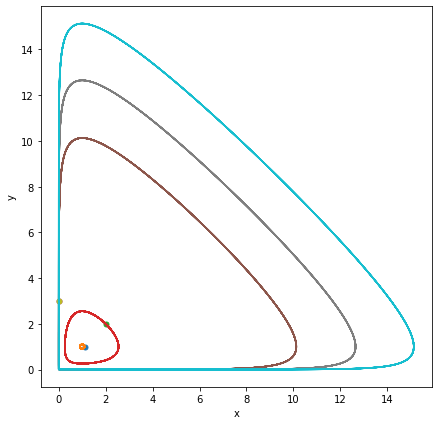

In [ ]:
plot_tracks(np.array([[1.1, 1], [2, 2], [0.001, 3], [0.0001, 3], [0.00001, 3]]), Lotka_Volterra, 100000)

$$p(x)=\dfrac{c}{σ^2}Exp\left(\dfrac{a[x(x-2b)-x_0(x_0-2b)]}{σ^2}\right)$$